# Airbnb Paris dataset analysis

## Datacamp 2021
<blockquote> 
Alexandre PERBET<br>
Cyril NERIN<br>
Hugo RIALAN<br>
Paul ORLUC<br>
Walid CHRIMNI<br>
Zakaria BEKKR<br>
</blockquote>

<br>
<img src="./files/Airbnb_Logo.svg" width="400" height="200">
<br>

__INTRODUCTION__

__Airbnb__ is a community platform service that connects travelers with hotel companies, rental property investors, and individuals who rent out all or part of their own home as a spare home. The site offers a search and booking platform between the person offering their accommodation and a renter. It covers more than 1.5 million rental ads in over 34,000 cities and 191 countries. In our study, we will restrict ourselves to the city of Paris.

__We will use Machine Learning algorithms to predict the price of an Airbnb rental in Paris.__

The use case of our work would be :
- either to predict the price of an apartment rental based on its characteristics to advise owners  
- or to detect price anomalies and warn a client that an ad is potentially a scam 

__Data source__ : http://insideairbnb.com/get-the-data.html

<div class="alert alert-block alert-success">
</div>

### Table of Contents

* [<b>01. Load Data</b>](#Load-Data)
    
* [<b>02. Exploratory data analysis</b>](#Exploratory-data-analysis)

* [<b>03. Cleaning the data set</b>](#Cleaning-the-data-set)

* [<b>04. Univariate Analysis</b>](#Univariate-Analysis)

* [<b>05. Feature Engineering</b>](#Feature-Engineering)

* [<b>06. Evaluation of regression models</b>](#Evaluation-of-regression-models)

* [<b>07. Selecting best features</b>](#Selecting-best-features)

* [<b>08. Model optimisation</b>](#Model-optimisation)

* [<b>09. Visualize prediction</b>](#Visualize-prediction)

* [<b>10. Explainability</b>](#Explainability)

* [<b>11. Conclusion</b>](#Conclusion)

<div class="alert alert-block alert-success">
</div>

In [1]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
%load_ext autoreload
%autoreload 2
%matplotlib inline

## Libraries

In [2]:
!pip3 install --quiet -r requirements.txt

In [3]:
!jupyter nbextension enable --py widgetsnbextension
!jupyter trust airbnb-starting-kit.ipynb

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: ok


Notebook already signed: airbnb-starting-kit.ipynb


In [4]:
import os

import sys 
print("Python version: {}". format(sys.version))

import IPython
from IPython import display
from IPython.display import Markdown, display, HTML
print("IPython version: {}". format(IPython.__version__))

import numpy as np
print("NumPy version: {}". format(np.__version__))

import scipy as sp
from scipy import stats
print("SciPy version: {}". format(sp.__version__))

import pandas as pd
print("pandas version: {}". format(pd.__version__))

import matplotlib
import matplotlib.pyplot as plt
print("matplotlib version: {}". format(matplotlib.__version__))

import seaborn as sns
print("seaborn version : {}". format(sns.__version__))
sns.set()

import missingno as msno
print("missingno version : {}". format(msno.__version__))

import pandas_profiling
print("pandas_profiling version : {}". format(pandas_profiling.__version__))

import folium
print("folium version : {}". format(folium.__version__))

import wordcloud
print("wordcloud version : {}". format(wordcloud.__version__))

import ipywidgets
print("ipywidgets version : {}". format(ipywidgets.__version__))

import sklearn
print("scikit-learn version : {}". format(sklearn.__version__))

import shap
print("shap version: {}". format(shap.__version__))

import warnings
warnings.filterwarnings('ignore')

print("====================================")

Python version: 3.9.7 (default, Sep 16 2021, 16:59:28) [MSC v.1916 64 bit (AMD64)]
IPython version: 7.27.0
NumPy version: 1.20.3
SciPy version: 1.7.1
pandas version: 1.3.2
matplotlib version: 3.4.2
seaborn version : 0.11.2
missingno version : 0.5.0
pandas_profiling version : 3.1.0
folium version : 0.12.1.post1
wordcloud version : 1.8.1
ipywidgets version : 7.6.5
scikit-learn version : 1.0.1
shap version: 0.40.0


## Utility functions

In [5]:
def printmd(text, couleur=None):
    """
    Printing of the string text by choosing the style (for example bold) and the color (couleur)
    """
    colorstr = "<span style='color:{}'>{}</span>".format(couleur, text)
    display(Markdown(colorstr))

# 01. Load Data<a class="anchor" id="Load-Data"></a>

In [6]:
import zipfile
 
zip_file = "./data/airbnb_compressed.zip"

try:
    with zipfile.ZipFile(zip_file) as z:
        z.extractall("./data")
        print("Extracted all")
except:
    print("Invalid file")

Extracted all


In [7]:
# df_main => cleaned summary of the dataset, good for visualisations
df_main = pd.read_csv('./data/airbnb_paris.csv', index_col='id')

# df_listings => detailed dataset with all collected columns
df_listings = pd.read_csv('./data/listings.csv', index_col='id')

# 02. Exploratory data analysis<a class="anchor" id="Exploratory-data-analysis"></a>

The goal of this part is to compute exploratory data analysis on the dataset to have a good overview of it and gain information. 

As some part require accurate information, we also do some little preprocessing to have the best exploratory analysis possible.

## Data dictionary

In [8]:
data_folder = "data"
file_name = "Inside_Airbnb_Data_Dictionary.csv"
dictionary_file_path = os.path.join(".", data_folder, file_name)
separateur = ";"
pd.options.display.max_rows = 80
df_dictionary = pd.read_csv(dictionary_file_path, sep=separateur, index_col="Field")
df_dictionary[["Type", "Description"]]

,Type,Description
Field,,
id,integer,Airbnb's unique identifier for the listing
listing_url,text,NaN
scrape_id,bigint,"Inside Airbnb ""Scrape"" this was part of"
last_scraped,datetime,"UTC. The date and time this listing was ""scrap..."
name,text,Name of the listing
description,text,Detailed description of the listing
neighborhood_overview,text,Host's description of the neighbourhood
picture_url,text,URL to the Airbnb hosted regular sized image f...
host_id,integer,Airbnb's unique identifier for the host/user


## The data from df_main

In [9]:
df_main.head()

,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
id,,,,,,,,,,,,,,,,,
5396,Explore the heart of old Paris,7903,Borzou,NaN,Hôtel-de-Ville,48.85247,2.35835,Entire home/apt,102,2,273,2021-12-08,1.80,1,58,42,7510402838018
7397,MARAIS - 2ROOMS APT - 2/4 PEOPLE,2626,Franck,NaN,Hôtel-de-Ville,48.85909,2.35315,Entire home/apt,112,10,288,2021-12-05,2.22,2,209,19,7510400829623
7964,Large & sunny flat with balcony !,22155,Anaïs,NaN,Opéra,48.87417,2.34245,Entire home/apt,130,6,6,2015-09-14,0.04,1,344,0,7510903576564
9359,"Cozy, Central Paris: WALK or VELIB EVERYWHERE !",28422,Bernadette,NaN,Louvre,48.86006,2.34863,Entire home/apt,75,180,0,NaN,NaN,1,117,0,"Available with a mobility lease only (""bail mo..."
9952,Paris petit coin douillet,33534,Elisabeth,NaN,Popincourt,48.86373,2.37093,Entire home/apt,81,4,33,2021-10-22,0.31,1,260,7,7511101582862


In [10]:
df_main.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49429 entries, 5396 to 53712667
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   name                            49384 non-null  object 
 1   host_id                         49429 non-null  int64  
 2   host_name                       49397 non-null  object 
 3   neighbourhood_group             0 non-null      float64
 4   neighbourhood                   49429 non-null  object 
 5   latitude                        49429 non-null  float64
 6   longitude                       49429 non-null  float64
 7   room_type                       49429 non-null  object 
 8   price                           49429 non-null  int64  
 9   minimum_nights                  49429 non-null  int64  
 10  number_of_reviews               49429 non-null  int64  
 11  last_review                     38767 non-null  object 
 12  reviews_per_month         

__We notice that the attribute "neighbourhood_group" is not filled in__

In [11]:
df_main.describe()

,host_id,neighbourhood_group,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,4.942900e+04,0.0,49429.000000,49429.000000,49429.000000,49429.000000,49429.000000,38767.000000,49429.000000,49429.000000,49429.000000
mean,9.896725e+07,NaN,48.864008,2.344914,129.891986,109.405086,21.636590,0.796471,10.652188,99.513059,3.635801
std,1.208700e+08,NaN,0.018181,0.033072,217.186069,168.774442,46.339395,1.191827,35.528471,134.092923,13.033774
min,2.626000e+03,NaN,48.812580,2.225720,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000
25%,1.340742e+07,NaN,48.850820,2.324110,61.000000,2.000000,1.000000,0.120000,1.000000,0.000000,0.000000
50%,3.883365e+07,NaN,48.865320,2.347900,90.000000,4.000000,6.000000,0.370000,1.000000,3.000000,0.000000
75%,1.470187e+08,NaN,48.878530,2.369270,140.000000,365.000000,21.000000,1.000000,2.000000,198.000000,3.000000
max,4.350258e+08,NaN,48.904860,2.472030,10250.000000,9999.000000,1809.000000,50.860000,252.000000,365.000000,1705.000000


### Location of the apartments for rent

In [12]:
# https://python-visualization.github.io/folium/
import folium, folium.plugins 
paris_location = [48.86, 2.34]
map = folium.Map(location=paris_location, zoom_start=12)
folium.plugins.FastMarkerCluster(data=df_main[['latitude', 'longitude']]).add_to(map)
map.save( './files/map.html')
map

### Textual variables

In [13]:
def generate_wordcloud(df,col):
    content = ''
    stopwords = set(STOPWORDS)
    

    for val in df[col].values:
        
        val = str(val)
        tokens = val.split()
        for i in range(len(tokens)):
            tokens[i] = tokens[i].lower()
        
        content += " ".join(tokens)+" "

    wordcloud = WordCloud(width = 800, height = 800,
                    background_color ='white',
                    stopwords = stopwords,
                    min_font_size = 10).generate(content)
    
    # plot the WordCloud image
    
    plt.figure(figsize = (8, 8), facecolor = None)
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad = 0)


In [14]:
%matplotlib inline

#### column "name"

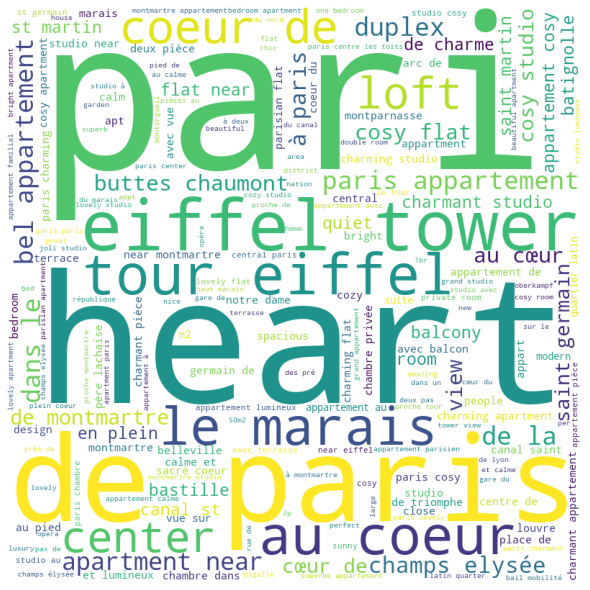

In [15]:
from wordcloud import WordCloud, STOPWORDS

generate_wordcloud(df_main,'name')

# the bigger the word, the more frequent it is in this field

We can see that the description of the apartments listed in our dataset are skewed towards upper class paris areas. We can also see that there is especially succesful appartment quality adjectives like : cosy, bright, charming etc

#### Column "neighbourhood"

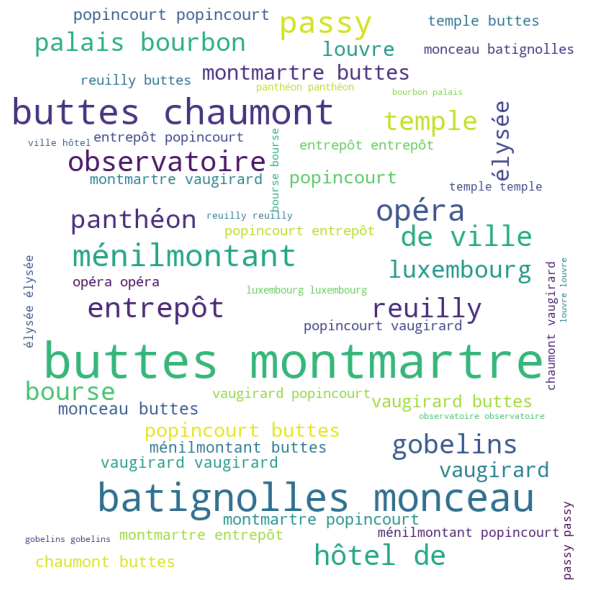

In [16]:
generate_wordcloud(df_main,'neighbourhood')

## The data from df_listings

In [17]:
df_listings.head()

,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
id,,,,,,,,,,,,,,,,,,,,,
5396,https://www.airbnb.com/rooms/5396,20211207182322,2021-12-09,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",https://a0.muscache.com/pictures/52413/f9bf76f...,7903,https://www.airbnb.com/users/show/7903,Borzou,...,4.81,4.96,4.53,7510402838018,f,1,1,0,0,1.80
7397,https://www.airbnb.com/rooms/7397,20211207182322,2021-12-09,MARAIS - 2ROOMS APT - 2/4 PEOPLE,"VERY CONVENIENT, WITH THE BEST LOCATION !<br /...",NaN,https://a0.muscache.com/pictures/67928287/330b...,2626,https://www.airbnb.com/users/show/2626,Franck,...,4.88,4.92,4.71,7510400829623,f,2,2,0,0,2.22
7964,https://www.airbnb.com/rooms/7964,20211207182322,2021-12-08,Large & sunny flat with balcony !,Very large & nice apartment all for you! <br /...,NaN,https://a0.muscache.com/pictures/4471349/6fb3d...,22155,https://www.airbnb.com/users/show/22155,Anaïs,...,5.00,5.00,5.00,7510903576564,f,1,1,0,0,0.04
9359,https://www.airbnb.com/rooms/9359,20211207182322,2021-12-09,"Cozy, Central Paris: WALK or VELIB EVERYWHERE !",Location! Location! Location! Just bring your ...,NaN,https://a0.muscache.com/pictures/c2965945-061f...,28422,https://www.airbnb.com/users/show/28422,Bernadette,...,NaN,NaN,NaN,"Available with a mobility lease only (""bail mo...",f,1,1,0,0,NaN
9952,https://www.airbnb.com/rooms/9952,20211207182322,2021-12-09,Paris petit coin douillet,"Je suis une dame retraitée, qui propose un agr...","Vibrant neighborhood, full of bars, cafés, fre...",https://a0.muscache.com/pictures/ae822d16-74d2...,33534,https://www.airbnb.com/users/show/33534,Elisabeth,...,4.91,4.91,4.94,7511101582862,f,1,1,0,0,0.31


In [18]:
df_listings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49429 entries, 5396 to 53712667
Data columns (total 73 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   listing_url                                   49429 non-null  object 
 1   scrape_id                                     49429 non-null  int64  
 2   last_scraped                                  49429 non-null  object 
 3   name                                          49384 non-null  object 
 4   description                                   48706 non-null  object 
 5   neighborhood_overview                         29455 non-null  object 
 6   picture_url                                   49428 non-null  object 
 7   host_id                                       49429 non-null  int64  
 8   host_url                                      49429 non-null  object 
 9   host_name                                     49397 non

In [19]:
df_listings.describe()

,scrape_id,host_id,host_listings_count,host_total_listings_count,neighbourhood_group_cleansed,latitude,longitude,accommodates,bathrooms,bedrooms,...,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
count,4.942900e+04,4.942900e+04,49397.000000,49397.000000,0.0,49429.000000,49429.000000,49429.000000,0.0,40293.000000,...,38124.00000,38105.000000,38117.000000,38103.000000,38100.000000,49429.000000,49429.000000,49429.000000,49429.000000,38767.000000
mean,2.021121e+13,9.896725e+07,13.513149,13.513149,NaN,48.864008,2.344914,3.044346,NaN,1.369990,...,4.59638,4.802476,4.813442,4.805913,4.618081,10.652188,9.945579,0.460904,0.019604,0.796471
std,1.172668e+01,1.208700e+08,83.562486,83.562486,NaN,0.018181,0.033072,1.622670,NaN,1.015249,...,0.53207,0.399383,0.401767,0.348673,0.464296,35.528471,35.404664,2.101099,0.306851,1.191827
min,2.021121e+13,2.626000e+03,0.000000,0.000000,NaN,48.812580,2.225720,0.000000,NaN,1.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.010000
25%,2.021121e+13,1.340742e+07,1.000000,1.000000,NaN,48.850820,2.324110,2.000000,NaN,1.000000,...,4.46000,4.760000,4.790000,4.750000,4.500000,1.000000,1.000000,0.000000,0.000000,0.120000
50%,2.021121e+13,3.883365e+07,1.000000,1.000000,NaN,48.865320,2.347900,2.000000,NaN,1.000000,...,4.75000,4.930000,4.950000,4.920000,4.720000,1.000000,1.000000,0.000000,0.000000,0.370000
75%,2.021121e+13,1.470187e+08,2.000000,2.000000,NaN,48.878530,2.369270,4.000000,NaN,2.000000,...,4.97000,5.000000,5.000000,5.000000,4.900000,2.000000,1.000000,0.000000,0.000000,1.000000
max,2.021121e+13,4.350258e+08,1288.000000,1288.000000,NaN,48.904860,2.472030,16.000000,NaN,50.000000,...,5.00000,5.000000,5.000000,5.000000,5.000000,252.000000,249.000000,30.000000,10.000000,50.860000


## Construction of the dataset that will be used for the analysis

In [20]:
df_main.columns

Index(['name', 'host_id', 'host_name', 'neighbourhood_group', 'neighbourhood',
       'latitude', 'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm', 'license'],
      dtype='object')

In [21]:
# display columns that are not already in df_main
for elt in df_listings.columns:
    if elt not in df_main.columns:
        print(elt, "(",df_listings[elt].dtype, ")", end=', ')

listing_url ( object ), scrape_id ( int64 ), last_scraped ( object ), description ( object ), neighborhood_overview ( object ), picture_url ( object ), host_url ( object ), host_since ( object ), host_location ( object ), host_about ( object ), host_response_time ( object ), host_response_rate ( object ), host_acceptance_rate ( object ), host_is_superhost ( object ), host_thumbnail_url ( object ), host_picture_url ( object ), host_neighbourhood ( object ), host_listings_count ( float64 ), host_total_listings_count ( float64 ), host_verifications ( object ), host_has_profile_pic ( object ), host_identity_verified ( object ), neighbourhood_cleansed ( object ), neighbourhood_group_cleansed ( float64 ), property_type ( object ), accommodates ( int64 ), bathrooms ( float64 ), bathrooms_text ( object ), bedrooms ( float64 ), beds ( float64 ), amenities ( object ), maximum_nights ( int64 ), minimum_minimum_nights ( float64 ), maximum_minimum_nights ( float64 ), minimum_maximum_nights ( float6

In [22]:
# Data dictionary : https://docs.google.com/spreadsheets/d/1iWCNJcSutYqpULSQHlNyGInUvHg2BoUGoNRIGa6Szc4/edit#gid=982310896
listings_cols_to_keep = ["host_is_superhost",
                        "accommodates", 
                        "bedrooms",
                        "beds",
                        "availability_60",
                        "number_of_reviews_l30d",
                        "availability_90",
                        "review_scores_accuracy",
                        "review_scores_cleanliness",
                        "review_scores_checkin",
                        "review_scores_communication",
                        "review_scores_location",
                        "review_scores_value"
                        # TODO Find More to add
                        ]
df = pd.merge(df_main, df_listings[listings_cols_to_keep], on='id', how='left')

In [23]:
df

,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,...,beds,availability_60,number_of_reviews_l30d,availability_90,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
id,,,,,,,,,,,,,,,,,,,,,
5396,Explore the heart of old Paris,7903,Borzou,NaN,Hôtel-de-Ville,48.852470,2.358350,Entire home/apt,102,2,...,1.0,28,3,58,4.56,4.48,4.77,4.81,4.96,4.53
7397,MARAIS - 2ROOMS APT - 2/4 PEOPLE,2626,Franck,NaN,Hôtel-de-Ville,48.859090,2.353150,Entire home/apt,112,10,...,2.0,5,2,24,4.79,4.43,4.91,4.88,4.92,4.71
7964,Large & sunny flat with balcony !,22155,Anaïs,NaN,Opéra,48.874170,2.342450,Entire home/apt,130,6,...,1.0,39,0,69,5.00,5.00,5.00,5.00,5.00,5.00
9359,"Cozy, Central Paris: WALK or VELIB EVERYWHERE !",28422,Bernadette,NaN,Louvre,48.860060,2.348630,Entire home/apt,75,180,...,1.0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
9952,Paris petit coin douillet,33534,Elisabeth,NaN,Popincourt,48.863730,2.370930,Entire home/apt,81,4,...,1.0,3,0,25,4.97,4.88,5.00,4.91,4.91,4.94
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53703809,Romantic Saint-Germain-des-Prés & Odeon ➳ NEW,23834078,Daniela,NaN,Luxembourg,48.851410,2.338214,Entire home/apt,290,30,...,4.0,54,0,84,NaN,NaN,NaN,NaN,NaN,NaN
53711459,CALM New deco APT.with a inner yard,418882378,Eléo,NaN,Opéra,48.877367,2.341647,Entire home/apt,88,1,...,1.0,39,0,69,NaN,NaN,NaN,NaN,NaN,NaN
53711747,Studio PAISIBLE for 2 in PARIS 20ème,435019549,Yassine,NaN,Ménilmontant,48.864185,2.404030,Entire home/apt,70,1,...,1.0,43,0,73,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49429 entries, 5396 to 53712667
Data columns (total 30 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   name                            49384 non-null  object 
 1   host_id                         49429 non-null  int64  
 2   host_name                       49397 non-null  object 
 3   neighbourhood_group             0 non-null      float64
 4   neighbourhood                   49429 non-null  object 
 5   latitude                        49429 non-null  float64
 6   longitude                       49429 non-null  float64
 7   room_type                       49429 non-null  object 
 8   price                           49429 non-null  int64  
 9   minimum_nights                  49429 non-null  int64  
 10  number_of_reviews               49429 non-null  int64  
 11  last_review                     38767 non-null  object 
 12  reviews_per_month         

In [25]:
df.describe()

,host_id,neighbourhood_group,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,...,beds,availability_60,number_of_reviews_l30d,availability_90,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
count,4.942900e+04,0.0,49429.000000,49429.000000,49429.000000,49429.000000,49429.000000,38767.000000,49429.000000,49429.000000,...,47485.000000,49429.000000,49429.000000,49429.000000,38119.000000,38124.00000,38105.000000,38117.000000,38103.000000,38100.000000
mean,9.896725e+07,NaN,48.864008,2.344914,129.891986,109.405086,21.636590,0.796471,10.652188,99.513059,...,1.729367,13.859698,0.458051,23.360922,4.760520,4.59638,4.802476,4.813442,4.805913,4.618081
std,1.208700e+08,NaN,0.018181,0.033072,217.186069,168.774442,46.339395,1.191827,35.528471,134.092923,...,1.354777,20.322719,1.391720,32.375636,0.422341,0.53207,0.399383,0.401767,0.348673,0.464296
min,2.626000e+03,NaN,48.812580,2.225720,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
25%,1.340742e+07,NaN,48.850820,2.324110,61.000000,2.000000,1.000000,0.120000,1.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,4.700000,4.46000,4.760000,4.790000,4.750000,4.500000
50%,3.883365e+07,NaN,48.865320,2.347900,90.000000,4.000000,6.000000,0.370000,1.000000,3.000000,...,1.000000,0.000000,0.000000,0.000000,4.880000,4.75000,4.930000,4.950000,4.920000,4.720000
75%,1.470187e+08,NaN,48.878530,2.369270,140.000000,365.000000,21.000000,1.000000,2.000000,198.000000,...,2.000000,27.000000,0.000000,51.000000,5.000000,4.97000,5.000000,5.000000,5.000000,4.900000
max,4.350258e+08,NaN,48.904860,2.472030,10250.000000,9999.000000,1809.000000,50.860000,252.000000,365.000000,...,90.000000,60.000000,62.000000,90.000000,5.000000,5.00000,5.000000,5.000000,5.000000,5.000000


# 03. Cleaning the data set<a class="anchor" id="Cleaning-the-data-set"></a>

## Dealing with Missing Values

<AxesSubplot:>

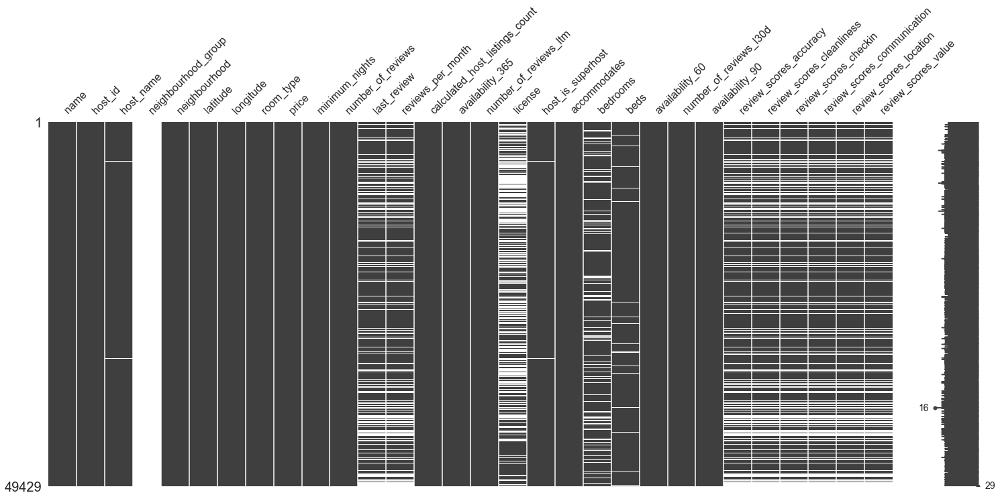

In [26]:
msno.matrix(df)

### Columns deletion

#### Neighbourhood_group

In [27]:
df['neighbourhood_group'].unique()

array([nan])

We note that the `neighbourhood_group` has only one unique value which is __nan__. As a result, this column is not filled in, we then delete it.

In [28]:
del df['neighbourhood_group']

#### License

In [29]:
df['license'].isna().sum() / len(df)

0.431062736450262

Moreover,`license` holds more than half of its content as missing values. Being a column bearing few meaning we choosed to delete it.

In [30]:
del df['license']

#### last_review

In [31]:
print("The last_review column (The date of the last/newest review) has {:.2%} missing data." \
      .format(df['last_review'].isna().sum() / len(df)))

The last_review column (The date of the last/newest review) has 21.57% missing data.


In addition, a relevant default date cannot be specified. We choosed to delete it.

In [32]:
del df['last_review']

In [33]:
df['host_name'] =  df['host_name'].fillna("NO_NAME")

### Replacement of missing data with default values

In [34]:
def process_empty(x):
    x = x.replace(' ','')
    return x if x!='' else np.NaN

for col in df.columns :
    try:
        df[col] = df[col].apply(process_empty)
    except:
        pass

In [35]:
data_type = {
    'int':['id','price','host_id','minimum_nights','calculated_host_listings_count',
           'availability_365','number_of_reviews_ltm'],
    'float':['latitude','longitude','reviews_per_month'],
    'datetime':['last_review'],
    'object':['name','host_name','room_type']
}


for col in df.columns:
    for key, values in data_type.items():

        if col in values:
            if key == 'datetime':
                df[col] = pd.to_datetime(df[col])
                df['last_review'] = df['last_review'].dt.strftime('%d-%m-%Y')                
            else:
                df[col] = df[col].astype(key)

In [36]:
df['reviews_per_month'] = df['reviews_per_month'].fillna(0)

In [37]:
df['host_is_superhost'] = df['host_is_superhost'].fillna('f')

In [38]:
# df_listings[df_listings['bedrooms'].isna()]['listing_url']
# quand bedrooms = NaN, pas de chambre, ex studio 
df['bedrooms'] = df['bedrooms'].fillna(0)
df['beds']     = df['beds'].fillna(1)

In [39]:
df['name'] = df['name'].fillna(" ")

In [40]:
scores = ['accuracy', 'cleanliness', 'checkin', 'communication', 'location', 'value']
df['review_scores_' + scores[0]].isna().sum() / df.shape[0]

for elt in scores: 
    index_with_nan = df.index[df[['review_scores_' + elt]].isnull().any(axis=1)]
    df.drop(index_with_nan,axis=0, inplace=True)

<AxesSubplot:>

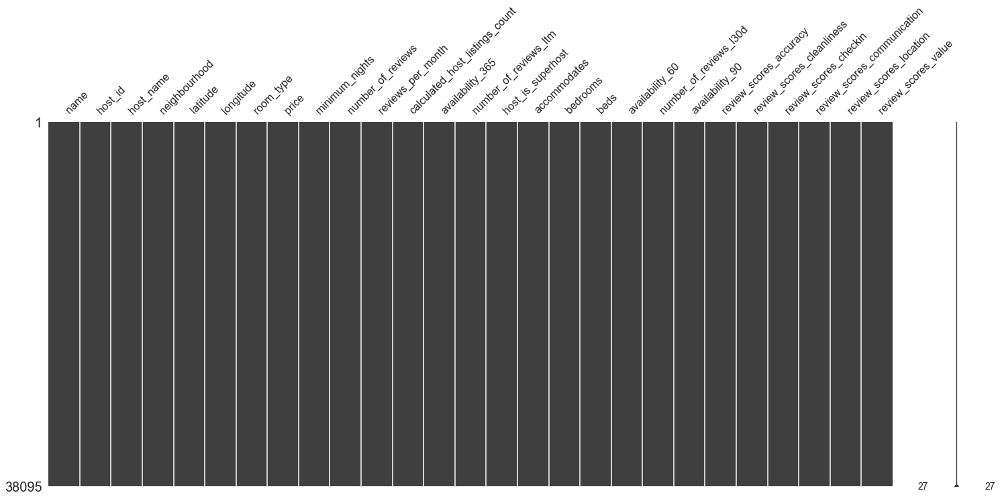

In [41]:
msno.matrix(df)

As we can see in the following output, in our new, cleaned data set, we no longer have any missing data:

In [42]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38095 entries, 5396 to 53669791
Data columns (total 27 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   name                            38095 non-null  object 
 1   host_id                         38095 non-null  int32  
 2   host_name                       38095 non-null  object 
 3   neighbourhood                   38095 non-null  object 
 4   latitude                        38095 non-null  float64
 5   longitude                       38095 non-null  float64
 6   room_type                       38095 non-null  object 
 7   price                           38095 non-null  int32  
 8   minimum_nights                  38095 non-null  int32  
 9   number_of_reviews               38095 non-null  int64  
 10  reviews_per_month               38095 non-null  float64
 11  calculated_host_listings_count  38095 non-null  int32  
 12  availability_365          

## Outliers processing

__An outlier of a dataset is defined as a value that is more than 3 standard deviations from the mean.__

In [43]:
df.describe()

,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,...,beds,availability_60,number_of_reviews_l30d,availability_90,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
count,3.809500e+04,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,...,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000,38095.000000
mean,9.369813e+07,48.863862,2.345970,122.423783,90.069720,28.052815,0.809993,9.625856,100.677175,4.717181,...,1.713112,13.537735,0.594277,23.171256,4.760658,4.596519,4.802792,4.813728,4.805951,4.618057
std,1.161688e+08,0.018109,0.032499,181.146475,160.968654,51.055294,1.197874,33.324839,132.730567,14.673778,...,1.409655,19.494251,1.559542,31.384957,0.421444,0.531285,0.397959,0.400307,0.348554,0.464299
min,2.626000e+03,48.812580,2.229290,0.000000,1.000000,1.000000,0.010000,1.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.246941e+07,48.850790,2.325840,62.000000,2.000000,4.000000,0.130000,1.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,4.700000,4.460000,4.760000,4.790000,4.750000,4.500000
50%,3.730673e+07,48.865110,2.348850,90.000000,3.000000,10.000000,0.380000,1.000000,7.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,4.880000,4.750000,4.930000,4.950000,4.920000,4.720000
75%,1.362256e+08,48.878235,2.370150,137.000000,30.000000,30.000000,1.000000,2.000000,203.000000,5.000000,...,2.000000,26.000000,0.000000,49.000000,5.000000,4.960000,5.000000,5.000000,5.000000,4.900000
max,4.346335e+08,48.904860,2.472030,9280.000000,9999.000000,1809.000000,50.860000,252.000000,365.000000,1705.000000,...,90.000000,60.000000,62.000000,90.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


Two features are not displayed in the table above: "accommodates" and "bedrooms"

In [44]:
df[["accommodates", "bedrooms"]].describe()

,accommodates,bedrooms
count,38095.00000,38095.000000
mean,3.06384,1.111799
std,1.62012,1.068073
min,0.00000,0.000000
25%,2.00000,1.000000
50%,2.00000,1.000000
75%,4.00000,1.000000
max,16.00000,50.000000


### The variable 'price' (target variable)

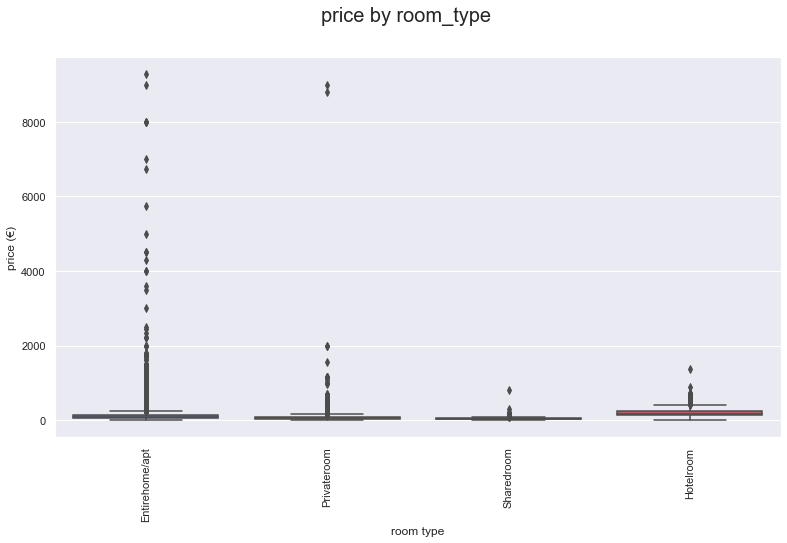

In [45]:
f, ax = plt.subplots(figsize=(13, 7))

sns.boxplot(data=df, x='room_type', y='price', ax=ax)
ax.set_ylabel('price (€)')
ax.set_xlabel('room type')
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

_ = f.suptitle('price by room_type', fontsize=20)

<div class="alert alert-block alert-warning"> 
<p><b>WARNING:</b> We observe abnormally high prices for the categories "Entire_home/Apt" and "private_room". These outliers on the target variable prevent us from having a good Machine Learning model. We need to remove them.</p>
</div>

<div class="alert alert-block alert-info"> 
<p><b>NOTE:</b> The outliers impact the value of the mean and standard deviation of the values. As our outlier selection algorithm uses these two quantities and as we perform only one selection step, there will be outliers after our treatment but the maximum price obtained will not penalize future processing.</p>
</div>

In [46]:
target = df['price'] 

# Deletion of rows with a negative or zero price
condition_positive_price = target > 0
df = df[condition_positive_price]

# Selection of outliers for price by room type
filtered_entries = []
for room_type in df['room_type'].unique():
    condition = df['room_type'] == room_type
    df_room_filtered = df[condition]
    z_scores = stats.zscore(df_room_filtered['price'])
    abs_z_scores = np.abs(z_scores)
    # filter the values less than 3 standard deviations from the mean
    filtre = abs_z_scores < 3
    filtered_entries.append(filtre)

rows_to_keep = pd.concat(filtered_entries)
rows_to_keep.sort_index(inplace=True)

nb_outliers = target.shape[0] - rows_to_keep.sum()

text_to_print = "{} appartments out of a total of {} (i.e. {:.2%}) are removed as outliers" \
                .format(nb_outliers, target.shape[0], nb_outliers/target.shape[0])
print(text_to_print)

296 appartments out of a total of 38095 (i.e. 0.78%) are removed as outliers


In [47]:
df = df[rows_to_keep]
df.shape

(37799, 27)

In [48]:
df['price'].describe()

count    37799.000000
mean       113.616366
std         83.096892
min          8.000000
25%         61.000000
50%         90.000000
75%        135.000000
max        663.000000
Name: price, dtype: float64

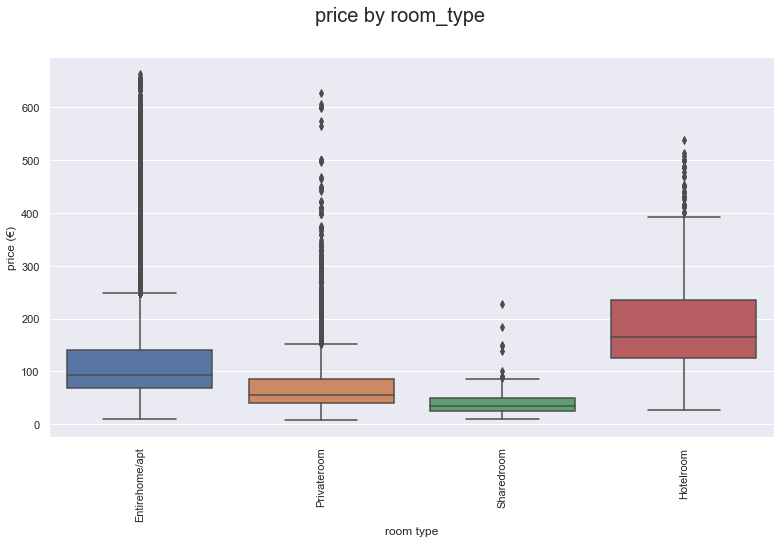

In [49]:
f, ax = plt.subplots(figsize=(13, 7))

sns.boxplot(data=df, x='room_type', y='price', ax=ax)
ax.set_ylabel('price (€)')
ax.set_xlabel('room type')
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

_ = f.suptitle('price by room_type', fontsize=20)

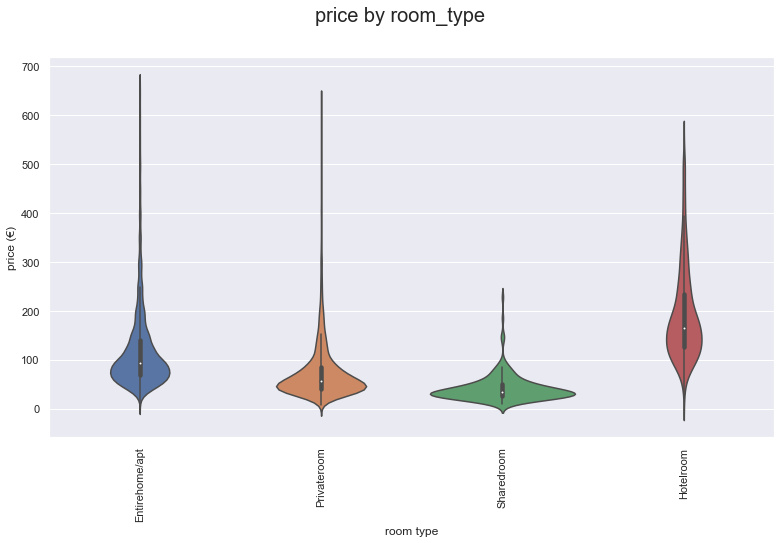

In [50]:
f, ax = plt.subplots(figsize=(13, 7))

sns.violinplot(data=df, x='room_type', y='price', ax=ax)
ax.set_ylabel('price (€)')
ax.set_xlabel('room type')
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

_ = f.suptitle('price by room_type', fontsize=20)

<div class="alert alert-block alert-info">
    <p><b>NOTE:</b> The average price and the distribution of prices around this average value are very different according to the variable room_type</p>
</div>

# 04. Univariate Analysis<a class="anchor" id="Univariate-Analysis"></a>

## Profiling the dataset df

In [51]:
from pandas_profiling import ProfileReport
# Caution: Profiling the df dataset is time consuming
profile = ProfileReport(df, title='df Profiling Report', html={'style':{'full_width':True}}, \
                        vars = {'cat': {'check_composition' : False}})
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [52]:
profile.to_file("./files/airbnb_data_exp.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Target variable description

<AxesSubplot:xlabel='price', ylabel='Count'>

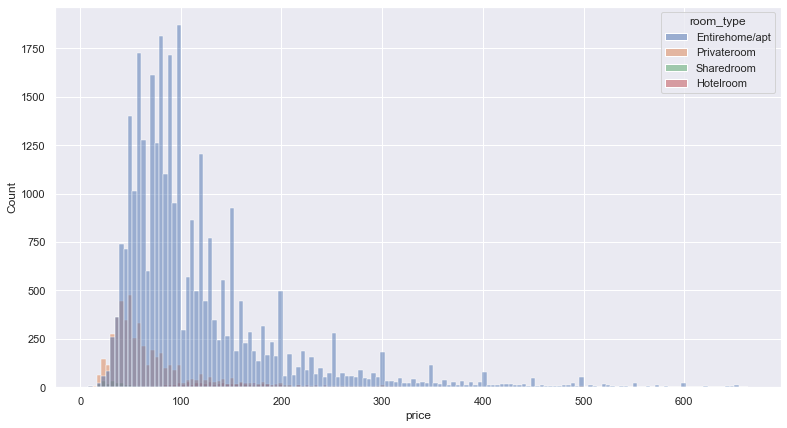

In [53]:
f, ax = plt.subplots(figsize=(13, 7))
sns.histplot(data=df, x="price", hue='room_type', ax=ax)

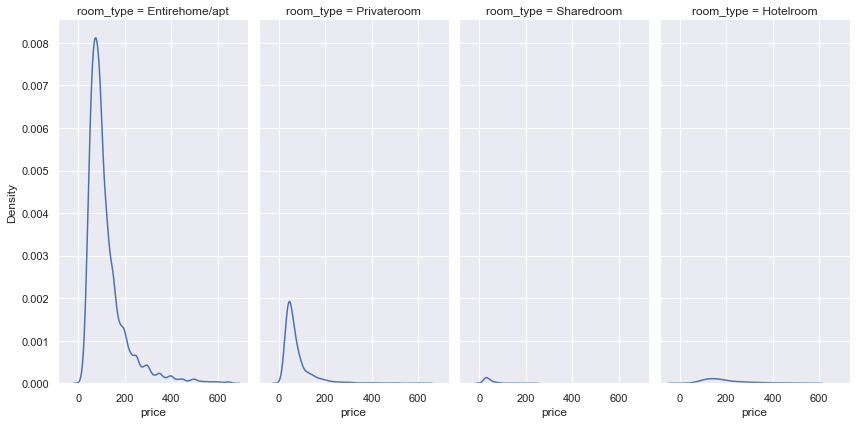

In [54]:
sns.displot(data=df, x='price', col='room_type', kind="kde", height=6, aspect=0.5)

As expected, the most expensive room are the houses where the entire home is available. We don't have much data on the two last categories (shared room and hotel room) so we can't say much about it.

In [55]:
df_Nb_rooms_by_type = pd.DataFrame(df['room_type'].value_counts())
df_Nb_rooms_by_type["percent"] = df_Nb_rooms_by_type['room_type'] / df.shape[0] * 100
df_Nb_rooms_by_type.columns = ['number', 'percent']
df_Nb_rooms_by_type

,number,percent
Entirehome/apt,31898,84.388476
Privateroom,4969,13.145850
Hotelroom,718,1.899521
Sharedroom,214,0.566153


In [56]:
# The room type label is recorded before it is encoded into digital form
Nom_type_Appt = df_Nb_rooms_by_type.index.tolist()

<AxesSubplot:ylabel='number'>

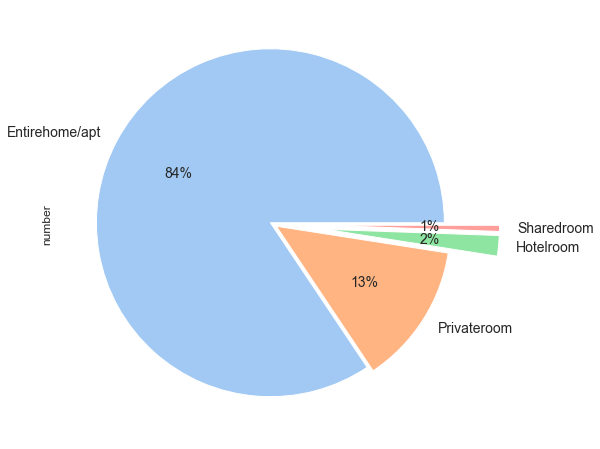

In [57]:
colors = sns.color_palette('pastel')
explode = [0.02, 0.02, 0.3, 0.3]
df_Nb_rooms_by_type['number'].plot.pie(colors = colors,
                             fontsize = 14,
                             autopct = '%0.0f%%',
                             explode = explode,                             
                             figsize=(8, 8))

<AxesSubplot:xlabel='price', ylabel='neighbourhood'>

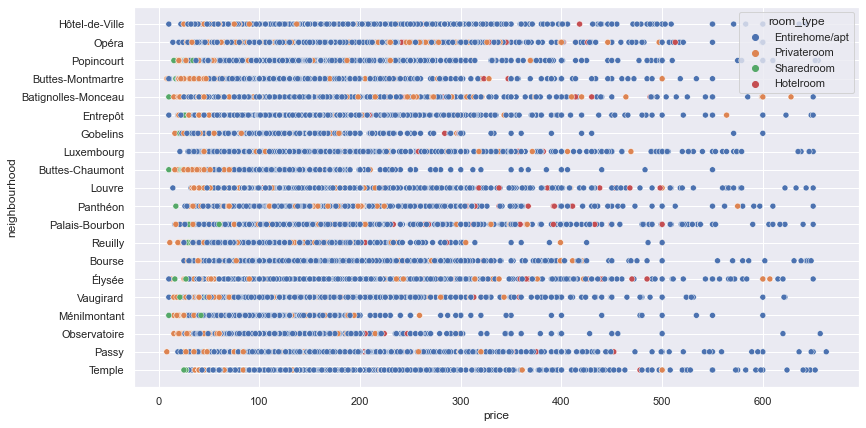

In [58]:
plt.figure(figsize=(13,7))
sns.scatterplot(data=df, x='price', y='neighbourhood', hue='room_type')

This plot show us the prices according to the neighborhood. The location has a significant impact on the price: for example, a room in Gobelin is cheaper than a room in Luxembourg

## Correlation of 'price' with other variables

__The coefficient of determination (squared correlation) is calculated to ignore the sign of the value__

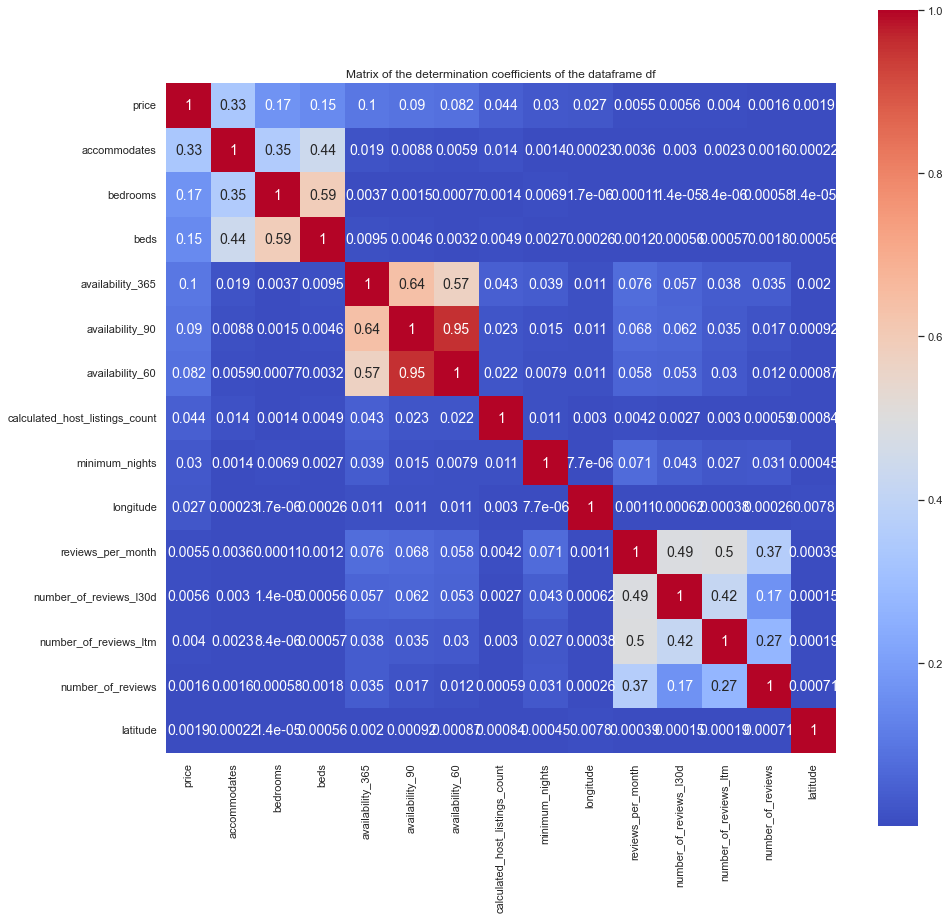

In [59]:
# We use the result of the profiling to select the columns

Colonnes_retenues = ['price',
                     'accommodates',
                     'bedrooms',
                     'beds',
                     'availability_365',
                     'availability_90',
                     'availability_60',
                     'calculated_host_listings_count',
                     'minimum_nights',
                     'longitude',
                     'reviews_per_month', 
                     'number_of_reviews_l30d',
                     'number_of_reviews_ltm',
                     'number_of_reviews',
                     'latitude']

fig, ax = plt.subplots(figsize=(15,15)) 
sns.heatmap(df[Colonnes_retenues].corr()**2, 
            annot=True, square=True, cmap='coolwarm', annot_kws={'size': 14}, ax=ax)
plt.title("Matrix of the determination coefficients of the dataframe df")
plt.show()

We note that the variable 'price' is mainly correlated to the variables 'accommodates', 'bedrooms', 'beds' and 'availability_*'. We will therefore reduce the selected variables to improve the readability of the matrix of coefficients of determination.

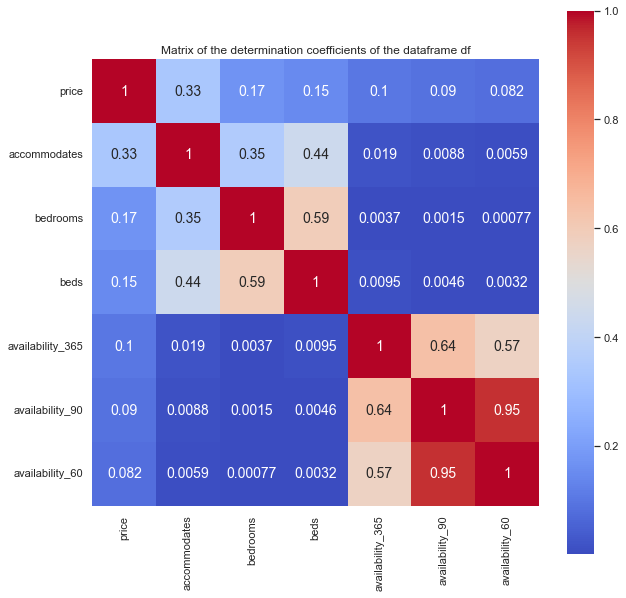

In [60]:
Colonnes_retenues = ['price',
                     'accommodates',
                     'bedrooms',
                     'beds',
                     'availability_365',
                     'availability_90',
                     'availability_60']

fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(df[Colonnes_retenues].corr()**2, 
            annot=True, square=True, cmap='coolwarm', annot_kws={'size': 14}, ax=ax)
plt.title("Matrix of the determination coefficients of the dataframe df")
plt.show()

# 05. Feature Engineering<a class="anchor" id="Feature-Engineering"></a>

## Preprocessing

In [61]:
df.columns

Index(['name', 'host_id', 'host_name', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm', 'host_is_superhost', 'accommodates',
       'bedrooms', 'beds', 'availability_60', 'number_of_reviews_l30d',
       'availability_90', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value'],
      dtype='object')

In [62]:
df_model = df.drop(columns=['name', 'host_id', 'host_name'])

In [63]:
X = df_model.drop(['price'], axis=1)
y = df_model['price']

In [64]:
X.columns[X.dtypes == 'object']

Index(['neighbourhood', 'room_type', 'host_is_superhost'], dtype='object')

In [65]:
from sklearn.preprocessing import OrdinalEncoder
for object_col in X.columns[X.dtypes == 'object']:
    enc = OrdinalEncoder()
    enc.fit(X[[object_col]])
    enc.categories_
    X[object_col] = enc.transform(X[[object_col]])

In [66]:
# standardization of the variables
X = X / X.max()
X.describe()

,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,...,beds,availability_60,number_of_reviews_l30d,availability_90,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
count,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,...,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000,37799.000000
mean,0.486508,0.999162,0.949054,0.099632,0.009035,0.015545,0.015969,0.037526,0.274039,0.002777,...,0.018854,0.223485,0.009623,0.255275,0.952224,0.919214,0.960683,0.962890,0.961189,0.923754
std,0.316529,0.000371,0.013138,0.237219,0.016120,0.028295,0.023619,0.130546,0.362791,0.008636,...,0.015389,0.323417,0.025233,0.347409,0.084046,0.106146,0.079177,0.079591,0.069548,0.092652
min,0.000000,0.998113,0.901805,0.000000,0.000100,0.000553,0.000197,0.003968,0.000000,0.000000,...,0.011111,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.157895,0.998894,0.940947,0.000000,0.000200,0.002211,0.002556,0.003968,0.000000,0.000000,...,0.011111,0.000000,0.000000,0.000000,0.940000,0.892000,0.954000,0.958000,0.950000,0.900000
50%,0.473684,0.999187,0.950207,0.000000,0.000300,0.006081,0.007471,0.003968,0.016438,0.000000,...,0.011111,0.000000,0.000000,0.000000,0.976000,0.950000,0.986000,0.990000,0.984000,0.944000
75%,0.789474,0.999457,0.958844,0.000000,0.003000,0.016584,0.019662,0.007937,0.550685,0.002933,...,0.022222,0.433333,0.000000,0.533333,1.000000,0.992000,1.000000,1.000000,1.000000,0.980000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


## Train and test data

__We keep the proportions of each type of rooms in the train and test datasets__

In [67]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=X["room_type"].values.tolist())

In [68]:
df_Train_rooms_by_type = pd.DataFrame(X_train['room_type'].value_counts())
df_Train_rooms_by_type["percent"] = df_Train_rooms_by_type['room_type'] / X_train.shape[0] * 100
df_Train_rooms_by_type.columns = ['number', 'percent']
df_Train_rooms_by_type

,number,percent
0.000000,25518,84.387711
0.666667,3975,13.145276
0.333333,575,1.901518
1.000000,171,0.565495


In [69]:
# room_type encoding relationship. 
# It will be used later in the notebook to make more explicit the outputs.
Label_room_type = {}
for i, indice in enumerate(df_Train_rooms_by_type.index.tolist()):
    Label_room_type[indice] = Nom_type_Appt[i]

In [70]:
df_Test_rooms_by_type = pd.DataFrame(X_test['room_type'].value_counts())
df_Test_rooms_by_type["percent"] = df_Test_rooms_by_type['room_type'] / X_test.shape[0] * 100
df_Test_rooms_by_type.columns = ['number', 'percent']
df_Test_rooms_by_type

,number,percent
0.000000,6380,84.391534
0.666667,994,13.148148
0.333333,143,1.891534
1.000000,43,0.568783


In [71]:
X_train.describe()

,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,...,beds,availability_60,number_of_reviews_l30d,availability_90,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
count,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,...,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000
mean,0.486759,0.999162,0.949030,0.099629,0.009017,0.015580,0.015889,0.037697,0.272589,0.002778,...,0.018909,0.221898,0.009513,0.253634,0.952316,0.918875,0.960411,0.962742,0.961016,0.923568
std,0.316435,0.000370,0.013131,0.237207,0.015295,0.028530,0.023775,0.131006,0.361839,0.009117,...,0.016314,0.322658,0.024640,0.346620,0.083951,0.106698,0.079476,0.080322,0.070285,0.092964
min,0.000000,0.998113,0.907242,0.000000,0.000100,0.000553,0.000197,0.003968,0.000000,0.000000,...,0.011111,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.157895,0.998894,0.940872,0.000000,0.000200,0.002211,0.002556,0.003968,0.000000,0.000000,...,0.011111,0.000000,0.000000,0.000000,0.940000,0.892000,0.952000,0.958000,0.950000,0.900000
50%,0.473684,0.999187,0.950187,0.000000,0.000300,0.006081,0.007471,0.003968,0.016438,0.000000,...,0.011111,0.000000,0.000000,0.000000,0.976000,0.950000,0.986000,0.990000,0.984000,0.944000
75%,0.789474,0.999456,0.958811,0.000000,0.003000,0.016584,0.019662,0.007937,0.543836,0.002933,...,0.022222,0.416667,0.000000,0.533333,1.000000,0.992000,1.000000,1.000000,1.000000,0.978000
max,1.000000,1.000000,0.998014,1.000000,0.112411,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [72]:
X_train.isna().sum()

neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
minimum_nights                    0
number_of_reviews                 0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
number_of_reviews_ltm             0
host_is_superhost                 0
accommodates                      0
bedrooms                          0
beds                              0
availability_60                   0
number_of_reviews_l30d            0
availability_90                   0
review_scores_accuracy            0
review_scores_cleanliness         0
review_scores_checkin             0
review_scores_communication       0
review_scores_location            0
review_scores_value               0
dtype: int64

# 06. Evaluation of regression models<a class="anchor" id="Evaluation-of-regression-models"></a>

## Selection of metrics

To quantify the performance of a regression model different evaluation metrics are possible. We have chosen to use three classical metrics.

__The Determination coefficient ($R^2$):__ It is the square of the Pearson correlation between the true values $y$ and the predicted values $\widehat y$. In regression, the $R^2$ coefficient of determination is a statistical measure of how well the regression predictions approximate the real data points. This value is also linked to the Explained Variance as $R^2 = 1 - Var_{explained}$. 

The Explained Variance is defined as follows:
$$
    Var_{explained}(y, \widehat y) = \frac{\sum_{i=1}^N (y_i - \widehat y_i)^2
                                         }{\sum_{i=1}^N (y_i - \bar y)^2}
    \enspace ,
$$
where $\bar y$ is the mean value of $y$.

An $R^2$ of 1 indicates that the regression predictions perfectly fit the data. A high $R^2$ is necessary for accurate predictions but a high $R^2$ does not always guarantee that the model is perfect.

__The Mean Absolute Error (MAE):__ this popular metric for regression use the $\ell_1$-norm to quantify the difference between the predictions and the true target *i.e.*
$$
    MAE(y, \widehat y) = \frac{1}{N}\sum_{i=1}^N |y_i - \widehat y_i| \enspace .
$$
Interpretation of the MAE is easy because it is represented in the same units as the original data. A perfect model produces an MAE equal to zero and the closer the observed MAE is to zero, the better the model fits the data.

Depending on the application of the regression problem, it might be necessary to use a metric which quantifies the relative error instead of the absolute error. There exists various ways to define such a metric, in particular:

__The Mean Absolute Pourcentage Error (MAPE):__ This metric computes the error between the predicted value and the target, and rescales it compared to the value of the target $y$ *i.e.*
$$
    MAPE(y, \widehat y) = \frac{1}{N}\sum_{i=1}^N \left| \frac{y_i-\widehat y_i}{y_i}\right|~.
$$  
This means that the same error of 1 won't have the same effect depending on the fact that $y=1$ or $y=1000$, which can be useful in our case where the rental prices of the apartments have a great amplitude although we have removed the biggest outliers. 

<div class="alert alert-block alert-info">
    <p><b>NOTE:</b> We will calculate the 3 metrics $R^2$, MAE and MAPE for each model tested on the Airbnb data but we will select the best model by using the <b>MAPE</b> metric that we feel is most appropriate for evaluating the prediction of apartment rental prices</p>
</div>

## Selection of best models

In [73]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.linear_model import ElasticNetCV
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from lightgbm import LGBMRegressor

Liste_modeles = {
                    "LinearRegression": LinearRegression(),
                    "Ridge": Ridge(random_state=0),
                    "Lasso": Lasso(random_state=0),
                    "LassoCV": LassoCV(cv=5, random_state=0),
                    "ElasticNetCV": ElasticNetCV(cv=5, random_state=0),
                    "SVR": SVR(),
                    "RandomForest": RandomForestRegressor(random_state=0),
                    "GradientBoosting": GradientBoostingRegressor(random_state=0),
                    "xgboost": XGBRegressor(random_state=0),
                    "HistGradientBoosting": HistGradientBoostingRegressor(random_state=0),
                    "LGBM": LGBMRegressor(random_state=0)
                }

In [74]:
from sklearn.metrics import mean_absolute_percentage_error, mean_absolute_error, r2_score

Eval_model = {}
Eval_model["model"] = []
Eval_model["R2"] = []
Eval_model["MAE"] = []
Eval_model["MAPE"] = []

for model in Liste_modeles:
    print("---------- {} ----------".format(model))
    reg = Liste_modeles[model].fit(X_train, y_train)
    y_pred = reg.predict(X_test)
    Eval_model["model"].append(model)
    Eval_model["R2"].append(r2_score(y_test, y_pred))
    Eval_model["MAE"].append(mean_absolute_error(y_test, y_pred))
    Eval_model["MAPE"].append(mean_absolute_percentage_error(y_test, y_pred))
    
print("")
df_eval_model = pd.DataFrame(Eval_model).set_index("model")
df_eval_model.sort_values(by="R2", ascending=False, inplace=True)
df_eval_model

---------- LinearRegression ----------
---------- Ridge ----------
---------- Lasso ----------
---------- LassoCV ----------
---------- ElasticNetCV ----------
---------- SVR ----------
---------- RandomForest ----------
---------- GradientBoosting ----------
---------- xgboost ----------
---------- HistGradientBoosting ----------
---------- LGBM ----------



,R2,MAE,MAPE
model,,,
LGBM,0.683257,28.359662,0.276543
HistGradientBoosting,0.682174,28.399236,0.276957
xgboost,0.666876,29.150442,0.283844
RandomForest,0.646438,30.342093,0.301693
GradientBoosting,0.635356,30.509478,0.299758
LassoCV,0.472134,38.041581,0.384235
LinearRegression,0.471976,38.137401,0.386669
Ridge,0.471896,38.054676,0.384005
Lasso,0.394156,41.129741,0.437296


## Cross validation 

In [75]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold

n_splits = 3
cv = KFold(n_splits=n_splits)
# The top-five models are selected
The_best_models = df_eval_model.head(5).index.values.tolist()

cross_valid = {}
for model in The_best_models:
    scores = cross_val_score(Liste_modeles[model],
                              X,
                              y,
                              cv=cv,
                              scoring='neg_mean_absolute_percentage_error')
    cross_valid[model] = - scores

df_cross_valid = pd.DataFrame(cross_valid)
moyenne = df_cross_valid.mean()
df_cross_valid = df_cross_valid.T
df_cross_valid["mean"] = moyenne
df_cross_valid.sort_values(by="mean", ascending=True, inplace=True)
df_cross_valid

,0,1,2,mean
LGBM,0.301746,0.281766,0.306362,0.296625
HistGradientBoosting,0.303814,0.281013,0.305325,0.296717
xgboost,0.309367,0.289668,0.330637,0.309891
GradientBoosting,0.318910,0.296269,0.327522,0.314234
RandomForest,0.332567,0.301288,0.380018,0.337958


In [76]:
The_best_model = df_cross_valid.head(1).index.values.tolist()[0]
print("The best model is {}.".format(The_best_model))

The best model is LGBM.


# 07. Selecting best features<a class="anchor" id="Selecting-best-features"></a>

Feature Selection is the process where you automatically or manually select those features which contribute most to your prediction variable or output in which you are interested in.

Having irrelevant features in your data can decrease the accuracy of the models and make your model learn based on irrelevant features.

$\textbf{Benefits of performing feature selection}$

- Reduces Overfitting: Less redundant data means less opportunity to make decisions based on noise.
- Improves Accuracy: Less misleading data means modeling accuracy improves.
- Reduces Training Time: fewer data points reduce algorithm complexity and algorithms train faster.


$\textbf{Method}$:
Feature importance is computed using <b>permutation importance method</b> for the top-five models. We then calculate an average feature importance for all models and remove the features with the lowest importance.

## Feature importance

In [77]:
from sklearn.inspection import permutation_importance

# The top-five models are selected
The_best_models = df_eval_model.head(5).index.values.tolist()

feature_importance_Train = {}
feature_importance_Test = {}
for model in The_best_models:
    print("---------- {} ----------".format(model))
    # Feature importance is computed using permutation importance method
    result = permutation_importance(Liste_modeles[model],
                                    X_train,
                                    y_train,
                                    n_repeats=10,
                                    random_state=42)
    feature_importance_Train[model] = result.importances_mean

    result = permutation_importance(Liste_modeles[model],
                                    X_test,
                                    y_test,
                                    n_repeats=10,
                                    random_state=42)
    feature_importance_Test[model] = result.importances_mean

df_feature_importance_Train = pd.DataFrame(feature_importance_Train)
df_feature_importance_Train["feature"] = X_train.columns
df_feature_importance_Train.set_index("feature", inplace=True)
# Scaling feature importance for the models
df_feature_importance_Train = df_feature_importance_Train / df_feature_importance_Train.max()
df_feature_importance_Train["mean"] = df_feature_importance_Train.mean(axis=1)
df_feature_importance_Train.sort_values(by="mean", ascending=False, inplace=True)

df_feature_importance_Test = pd.DataFrame(feature_importance_Test)
df_feature_importance_Test["feature"] = X_train.columns
df_feature_importance_Test.set_index("feature", inplace=True)
# Scaling feature importance for the models
df_feature_importance_Test = df_feature_importance_Test / df_feature_importance_Test.max()
df_feature_importance_Test["mean"] = df_feature_importance_Test.mean(axis=1)
df_feature_importance_Test.sort_values(by="mean", ascending=False, inplace=True)

---------- LGBM ----------
---------- HistGradientBoosting ----------
---------- xgboost ----------
---------- RandomForest ----------
---------- GradientBoosting ----------


In [78]:
df_feature_importance_Train

,LGBM,HistGradientBoosting,xgboost,RandomForest,GradientBoosting,mean
feature,,,,,,
bedrooms,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
accommodates,0.632348,0.729691,0.773161,0.387528,0.489944,0.602534
calculated_host_listings_count,0.368878,0.387123,0.506358,0.364150,0.322529,0.389808
longitude,0.411788,0.436007,0.470272,0.286933,0.247131,0.370426
minimum_nights,0.359780,0.374225,0.438253,0.212415,0.141076,0.305150
latitude,0.332627,0.343662,0.436486,0.224011,0.153853,0.298128
availability_60,0.214805,0.174526,0.287684,0.151319,0.129991,0.191665
availability_365,0.104778,0.116552,0.290170,0.211759,0.074613,0.159574
room_type,0.150976,0.169715,0.192643,0.084063,0.085077,0.136495


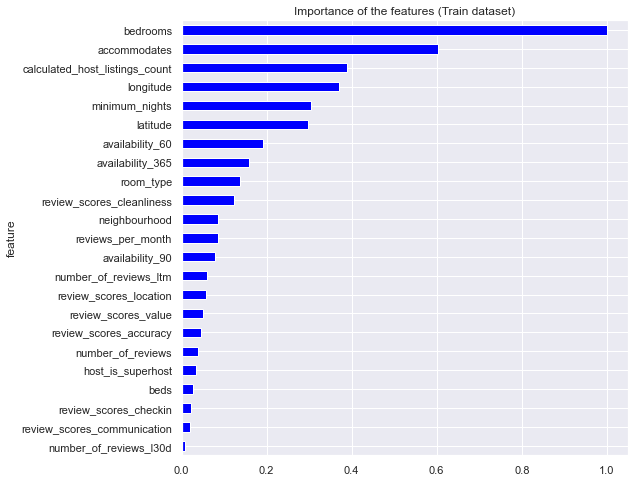

In [79]:
importance_moyenne = df_feature_importance_Train['mean'].sort_values()
ax = importance_moyenne.plot.barh(color="blue", figsize=(8,8), title="Importance of the features (Train dataset)")

In [80]:
df_feature_importance_Test

,LGBM,HistGradientBoosting,xgboost,RandomForest,GradientBoosting,mean
feature,,,,,,
bedrooms,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
accommodates,0.616423,0.705917,0.722156,0.299213,0.467716,0.562285
calculated_host_listings_count,0.372457,0.384003,0.468847,0.295704,0.333016,0.370805
longitude,0.412732,0.441371,0.421529,0.207025,0.270422,0.350616
minimum_nights,0.344280,0.353862,0.410574,0.159739,0.134698,0.280631
latitude,0.308724,0.325803,0.356332,0.133138,0.159521,0.256704
availability_60,0.207355,0.174104,0.282800,0.072733,0.131572,0.173713
room_type,0.156377,0.178615,0.192781,0.074884,0.085520,0.137635
availability_365,0.075801,0.092349,0.256397,0.106144,0.073770,0.120892


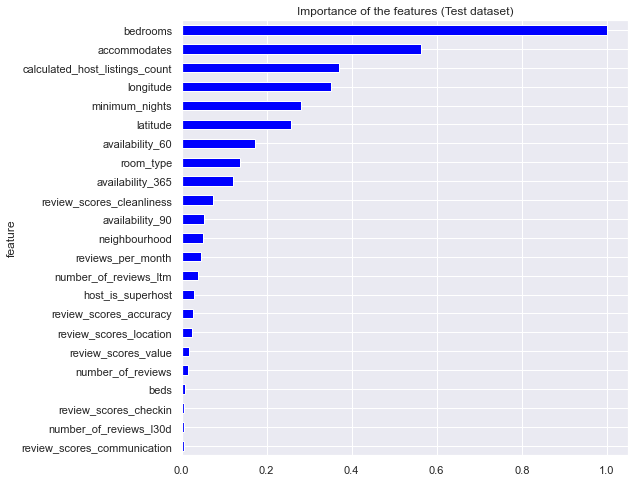

In [81]:
importance_moyenne = df_feature_importance_Test['mean'].sort_values()
ax = importance_moyenne.plot.barh(color="blue", figsize=(8,8), title="Importance of the features (Test dataset)")

<div class="alert alert-block alert-info">
    <p><b>NOTE:</b> We want to eliminate features that have an almost zero contribution on the price prediction on the test dataset. This is why we take a very low threshold (0.01) which eliminates 4 features.</p>
</div>

## Removal of the least important features

In [82]:
condition = df_feature_importance_Test['mean'] > 0.01
columns_to_keep = df_feature_importance_Test[condition].index.values.tolist()
print(columns_to_keep)

['bedrooms', 'accommodates', 'calculated_host_listings_count', 'longitude', 'minimum_nights', 'latitude', 'availability_60', 'room_type', 'availability_365', 'review_scores_cleanliness', 'availability_90', 'neighbourhood', 'reviews_per_month', 'number_of_reviews_ltm', 'host_is_superhost', 'review_scores_accuracy', 'review_scores_location', 'review_scores_value', 'number_of_reviews']


In [83]:
X_train_small = X_train[columns_to_keep]
X_train_small.describe()

,bedrooms,accommodates,calculated_host_listings_count,longitude,minimum_nights,latitude,availability_60,room_type,availability_365,review_scores_cleanliness,availability_90,neighbourhood,reviews_per_month,number_of_reviews_ltm,host_is_superhost,review_scores_accuracy,review_scores_location,review_scores_value,number_of_reviews
count,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000,30239.000000
mean,0.022113,0.189974,0.037697,0.949030,0.009017,0.999162,0.221898,0.099629,0.272589,0.918875,0.253634,0.486759,0.015889,0.002778,0.169913,0.952316,0.961016,0.923568,0.015580
std,0.022217,0.098811,0.131006,0.013131,0.015295,0.000370,0.322658,0.237207,0.361839,0.106698,0.346620,0.316435,0.023775,0.009117,0.375563,0.083951,0.070285,0.092964,0.028530
min,0.000000,0.062500,0.003968,0.907242,0.000100,0.998113,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000197,0.000000,0.000000,0.000000,0.000000,0.000000,0.000553
25%,0.020000,0.125000,0.003968,0.940872,0.000200,0.998894,0.000000,0.000000,0.000000,0.892000,0.000000,0.157895,0.002556,0.000000,0.000000,0.940000,0.950000,0.900000,0.002211
50%,0.020000,0.125000,0.003968,0.950187,0.000300,0.999187,0.000000,0.000000,0.016438,0.950000,0.000000,0.473684,0.007471,0.000000,0.000000,0.976000,0.984000,0.944000,0.006081
75%,0.020000,0.250000,0.007937,0.958811,0.003000,0.999456,0.416667,0.000000,0.543836,0.992000,0.533333,0.789474,0.019662,0.002933,0.000000,1.000000,1.000000,0.978000,0.016584
max,1.000000,1.000000,1.000000,0.998014,0.112411,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [84]:
X_test_small = X_test[columns_to_keep]
X_test_small.describe()

,bedrooms,accommodates,calculated_host_listings_count,longitude,minimum_nights,latitude,availability_60,room_type,availability_365,review_scores_cleanliness,availability_90,neighbourhood,reviews_per_month,number_of_reviews_ltm,host_is_superhost,review_scores_accuracy,review_scores_location,review_scores_value,number_of_reviews
count,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000,7560.000000
mean,0.021452,0.189724,0.036843,0.949152,0.009105,0.999163,0.229830,0.099647,0.279839,0.920570,0.261842,0.485505,0.016289,0.002771,0.174074,0.951853,0.961881,0.924496,0.015403
std,0.015553,0.095237,0.128698,0.013169,0.019068,0.000373,0.326377,0.237284,0.366541,0.103908,0.350493,0.316926,0.022981,0.006354,0.379198,0.084432,0.066519,0.091396,0.027338
min,0.000000,0.062500,0.003968,0.901805,0.000100,0.998189,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000197,0.000000,0.000000,0.000000,0.000000,0.000000,0.000553
25%,0.020000,0.125000,0.003968,0.941136,0.000200,0.998893,0.000000,0.000000,0.000000,0.892000,0.000000,0.157895,0.002556,0.000000,0.000000,0.940000,0.950000,0.900000,0.002211
50%,0.020000,0.125000,0.003968,0.950260,0.000300,0.999190,0.000000,0.000000,0.019178,0.950000,0.000000,0.473684,0.007865,0.000000,0.000000,0.976000,0.984000,0.946000,0.005528
75%,0.020000,0.250000,0.007937,0.958934,0.003000,0.999459,0.450000,0.000000,0.580822,0.994000,0.566667,0.789474,0.019711,0.002933,0.000000,1.000000,1.000000,0.980000,0.016031
max,0.100000,0.875000,1.000000,1.000000,1.000000,0.999911,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.434723,0.188270,1.000000,1.000000,1.000000,1.000000,0.381426


## Re-evaluation of regression models on the new data set

In [85]:
Eval_model = {}
Eval_model["model"] = []
Eval_model["R2"] = []
Eval_model["MAE"] = []
Eval_model["MAPE"] = []

for model in Liste_modeles:
    print("---------- {} ----------".format(model))
    reg = Liste_modeles[model].fit(X_train_small, y_train)
    y_pred = reg.predict(X_test_small)
    Eval_model["model"].append(model)
    Eval_model["R2"].append(r2_score(y_test, y_pred))
    Eval_model["MAE"].append(mean_absolute_error(y_test, y_pred))
    Eval_model["MAPE"].append(mean_absolute_percentage_error(y_test, y_pred))
    
print("")
df_eval_model_small = pd.DataFrame(Eval_model).set_index("model")
df_eval_model_small.sort_values(by="R2", ascending=False, inplace=True)
df_eval_model_small

---------- LinearRegression ----------
---------- Ridge ----------
---------- Lasso ----------
---------- LassoCV ----------
---------- ElasticNetCV ----------
---------- SVR ----------
---------- RandomForest ----------
---------- GradientBoosting ----------
---------- xgboost ----------
---------- HistGradientBoosting ----------
---------- LGBM ----------



,R2,MAE,MAPE
model,,,
HistGradientBoosting,0.680724,28.454447,0.276957
LGBM,0.679875,28.442029,0.276793
xgboost,0.669383,29.319357,0.287341
RandomForest,0.649203,30.257978,0.300864
GradientBoosting,0.636859,30.469092,0.299212
Ridge,0.469369,38.155843,0.384732
LassoCV,0.468441,38.199565,0.385538
LinearRegression,0.468292,38.261501,0.387182
Lasso,0.394147,41.130141,0.437300


In [86]:
n_splits = 3
cv = KFold(n_splits=n_splits)
# The top-five models are selected
The_best_models = df_eval_model.head(5).index.values.tolist()

cross_valid = {}
for model in The_best_models:
    scores = cross_val_score(Liste_modeles[model],
                              X[columns_to_keep],
                              y,
                              cv=cv,
                              scoring='neg_mean_absolute_percentage_error')
    cross_valid[model] = - scores

df_cross_valid_small = pd.DataFrame(cross_valid)
moyenne = df_cross_valid_small.mean()
df_cross_valid_small = df_cross_valid_small.T
df_cross_valid_small["mean"] = moyenne
df_cross_valid_small.sort_values(by="mean", ascending=True, inplace=True)
df_cross_valid_small

,0,1,2,mean
HistGradientBoosting,0.303180,0.282265,0.303628,0.296357
LGBM,0.301343,0.280662,0.307580,0.296528
GradientBoosting,0.317669,0.295536,0.326042,0.313083
xgboost,0.322794,0.288203,0.330936,0.313977
RandomForest,0.334633,0.301394,0.376729,0.337585


In [87]:
The_best_model = df_cross_valid_small.head(1).index.values.tolist()[0]
print("The best model is {}.".format(The_best_model))

The best model is HistGradientBoosting.


<div class="alert alert-block alert-info">
    <p><b>NOTE:</b> The removal of 4 features "beds", "review_scores_checkin", "number_of_reviews_l30d", "review_scores_communication" has no impact on the performance of the best regression models.</p>
</div>

# 08. Model optimisation<a class="anchor" id="Model-optimisation"></a>

## Searching the best hyper-parameters for the top-4 models

In [88]:
from sklearn.model_selection import GridSearchCV, RepeatedStratifiedKFold

MAPE_for_the_best_estimator = {}
The_best_estimator = {}

def model_optimisation(model, Xt, yt, the_grid):
    # define model evaluation method
    cv = RepeatedStratifiedKFold(n_splits=3, n_repeats=2, random_state=1)
    # define search
    the_search = GridSearchCV(model,
                              the_grid,
                              scoring='neg_mean_absolute_percentage_error',
                              cv=cv,
                              n_jobs=-1)
    # perform the search
    the_results = the_search.fit(Xt, yt)
    # summarize
    print("MAPE = {:.4f}".format(- the_results.best_score_))
    print("best params = {}".format(the_results.best_params_))
    
    return the_results

### HistGradientBoosting

In [89]:
# Parameters of the model
HistGradientBoostingRegressor(random_state=0).get_params()

{'categorical_features': None,
 'early_stopping': 'auto',
 'l2_regularization': 0.0,
 'learning_rate': 0.1,
 'loss': 'squared_error',
 'max_bins': 255,
 'max_depth': None,
 'max_iter': 100,
 'max_leaf_nodes': 31,
 'min_samples_leaf': 20,
 'monotonic_cst': None,
 'n_iter_no_change': 10,
 'random_state': 0,
 'scoring': 'loss',
 'tol': 1e-07,
 'validation_fraction': 0.1,
 'verbose': 0,
 'warm_start': False}

In [90]:
print("HistGradientBoostingRegressor")
# define grid search for Tree parameters
print("\nbest tree parameters ...")
HGBR_Boosting_grid = dict()
HGBR_Boosting_grid['learning_rate'] = [0.05, 0.1, 0,2, 0.3, 0.4]
HGBR_Boosting_grid['max_depth'] = [None, 2, 6, 10]
HGBR_results = model_optimisation(HistGradientBoostingRegressor(random_state=0),
                                  X_train_small,
                                  y_train,
                                  HGBR_Boosting_grid)
best_estimator_HGBR = HGBR_results.best_estimator_

MAPE_for_the_best_estimator["HistGradientBoosting"] = [- HGBR_results.best_score_]
The_best_estimator["HistGradientBoosting"] = HGBR_results.best_estimator_
print("\nBest estimator : {}".format(The_best_estimator["HistGradientBoosting"]))

HistGradientBoostingRegressor

best tree parameters ...
MAPE = 0.2850
best params = {'learning_rate': 0.1, 'max_depth': None}

Best estimator : HistGradientBoostingRegressor(random_state=0)


### LGBM

In [91]:
# Parameters of the model
LGBMRegressor(random_state=0).get_params()

{'boosting_type': 'gbdt',
 'class_weight': None,
 'colsample_bytree': 1.0,
 'importance_type': 'split',
 'learning_rate': 0.1,
 'max_depth': -1,
 'min_child_samples': 20,
 'min_child_weight': 0.001,
 'min_split_gain': 0.0,
 'n_estimators': 100,
 'n_jobs': -1,
 'num_leaves': 31,
 'objective': None,
 'random_state': 0,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'silent': 'warn',
 'subsample': 1.0,
 'subsample_for_bin': 200000,
 'subsample_freq': 0}

In [92]:
print("LGBMRegressor")
# define grid search for Gradient Boosting method
print("\nbest gradient boosting method ...")
LGBM_Boosting_grid = dict()
LGBM_Boosting_grid['boosting_type'] = ["gbdt", "goss", "dart"]
LGBM_results = model_optimisation(LGBMRegressor(random_state=0), X_train_small, y_train, LGBM_Boosting_grid)
best_estimator_LGBM_1 = LGBM_results.best_estimator_
print(best_estimator_LGBM_1)

# define grid search for Tree parameters
print("\nbest tree parameters ...")
LGBM_Boosting_grid = dict()
LGBM_Boosting_grid['learning_rate'] = [0.05, 0.1, 0.2, 0.3, 0.4]
LGBM_Boosting_grid['max_depth'] = [-1, 2, 6, 10]
LGBM_results = model_optimisation(best_estimator_LGBM_1, X_train_small, y_train, LGBM_Boosting_grid)
best_estimator_LGBM_2 = LGBM_results.best_estimator_

MAPE_for_the_best_estimator["LGBM"] = [- LGBM_results.best_score_]
The_best_estimator["LGBM"] = LGBM_results.best_estimator_
print("\nBest estimator : {}".format(The_best_estimator["LGBM"]))

LGBMRegressor

best gradient boosting method ...
MAPE = 0.2637
best params = {'boosting_type': 'dart'}
LGBMRegressor(boosting_type='dart', random_state=0)

best tree parameters ...
MAPE = 0.2632
best params = {'learning_rate': 0.1, 'max_depth': 6}

Best estimator : LGBMRegressor(boosting_type='dart', max_depth=6, random_state=0)


###  GradientBoosting

In [93]:
# Parameters of the model
GradientBoostingRegressor(random_state=0).get_params()

{'alpha': 0.9,
 'ccp_alpha': 0.0,
 'criterion': 'friedman_mse',
 'init': None,
 'learning_rate': 0.1,
 'loss': 'squared_error',
 'max_depth': 3,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_iter_no_change': None,
 'random_state': 0,
 'subsample': 1.0,
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': 0,
 'warm_start': False}

In [94]:
print("GradientBoostingRegressor")
# define grid search for Tree parameters
print("\nbest tree parameters ...")
GBR_Boosting_grid = dict()
GBR_Boosting_grid['learning_rate'] = [0.05, 0.1, 0.2, 0.3, 0.4]
GBR_Boosting_grid['max_depth'] = [2, 3, 4, 10]
GBR_results = model_optimisation(GradientBoostingRegressor(random_state=0),
                                  X_train_small,
                                  y_train,
                                  GBR_Boosting_grid)
best_estimator_GBR = GBR_results.best_estimator_

MAPE_for_the_best_estimator["GradientBoosting"] = [- GBR_results.best_score_]
The_best_estimator["GradientBoosting"] = GBR_results.best_estimator_
print("\nBest estimator : {}".format(The_best_estimator["GradientBoosting"]))

GradientBoostingRegressor

best tree parameters ...
MAPE = 0.2907
best params = {'learning_rate': 0.2, 'max_depth': 4}

Best estimator : GradientBoostingRegressor(learning_rate=0.2, max_depth=4, random_state=0)


### xgboost

In [95]:
# Parameters of the model
XGBRegressor(random_state=0).get_params()

{'objective': 'reg:squarederror',
 'base_score': None,
 'booster': None,
 'colsample_bylevel': None,
 'colsample_bynode': None,
 'colsample_bytree': None,
 'enable_categorical': False,
 'gamma': None,
 'gpu_id': None,
 'importance_type': None,
 'interaction_constraints': None,
 'learning_rate': None,
 'max_delta_step': None,
 'max_depth': None,
 'min_child_weight': None,
 'missing': nan,
 'monotone_constraints': None,
 'n_estimators': 100,
 'n_jobs': None,
 'num_parallel_tree': None,
 'predictor': None,
 'random_state': 0,
 'reg_alpha': None,
 'reg_lambda': None,
 'scale_pos_weight': None,
 'subsample': None,
 'tree_method': None,
 'validate_parameters': None,
 'verbosity': None}

In [96]:
print("XGBRegressor")
# define grid search for Gradient Boosting method
print("\nbest gradient boosting method ...")
XGBR_Boosting_grid = dict()
XGBR_Boosting_grid['booster'] = ["gbtree", "gblinear", "dart"]
XGBR_results = model_optimisation(XGBRegressor(random_state=0), X_train_small, y_train, XGBR_Boosting_grid)
best_estimator_XGBR_1 = XGBR_results.best_estimator_
print(best_estimator_XGBR_1)

# define grid search for Tree parameters
print("\nbest tree parameters ...")
XGBR_Boosting_grid = dict()
XGBR_Boosting_grid['learning_rate'] = [0.05, 0.1, 0.2, 0.3, 0.4]
XGBR_Boosting_grid['max_depth'] = [4, 5, 6, 10]
XGBR_results = model_optimisation(best_estimator_XGBR_1, X_train_small, y_train, XGBR_Boosting_grid)
best_estimator_XGBR_2 = XGBR_results.best_estimator_

MAPE_for_the_best_estimator["xgboost"] = [- XGBR_results.best_score_]
The_best_estimator["xgboost"] = XGBR_results.best_estimator_
print("\nBest estimator : {}".format(The_best_estimator["xgboost"]))

XGBRegressor

best gradient boosting method ...
MAPE = 0.2952
best params = {'booster': 'dart'}
XGBRegressor(base_score=0.5, booster='dart', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=12,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None)

best tree parameters ...
MAPE = 0.2854
best params = {'learning_rate': 0.1, 'max_depth': 6}

Best estimator : XGBRegressor(base_score=0.5, booster='dart', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0

## The final model

In [97]:
printmd("The best estimators sorted by MAPE value", couleur="blue")
df_MAPE_best_model = pd.DataFrame(MAPE_for_the_best_estimator).T
df_MAPE_best_model.columns = ['MAPE']
df_MAPE_best_model.sort_values(by='MAPE', ascending=True, inplace=True)
df_MAPE_best_model

<span style='color:blue'>The best estimators sorted by MAPE value</span>

,MAPE
LGBM,0.263209
HistGradientBoosting,0.284992
xgboost,0.285398
GradientBoosting,0.290695


In [98]:
Name_of_the_best_model = df_MAPE_best_model.head(1).index.values.tolist()[0]
The_final_model = The_best_estimator[Name_of_the_best_model]

# 09. Visualize prediction<a class="anchor" id="Visualize-prediction"></a>

In [99]:
printmd("The final model with the smallest MAPE value is: {}".format(The_final_model), couleur="blue")
The_final_model.fit(X_train_small, y_train)
y_pred = The_final_model.predict(X_test_small)
printmd("   MAPE = {}".format(mean_absolute_percentage_error(y_test, y_pred)), couleur="blue")
printmd("   MAE  = {}".format(mean_absolute_error(y_test, y_pred)), couleur="blue")
printmd("   R2   = {}".format(r2_score(y_test, y_pred)), couleur="blue")

<span style='color:blue'>The final model with the smallest MAPE value is: LGBMRegressor(boosting_type='dart', max_depth=6, random_state=0)</span>

<span style='color:blue'>   MAPE = 0.2572977990018527</span>

<span style='color:blue'>   MAE  = 30.154436307314718</span>

<span style='color:blue'>   R2   = 0.5952651171917671</span>

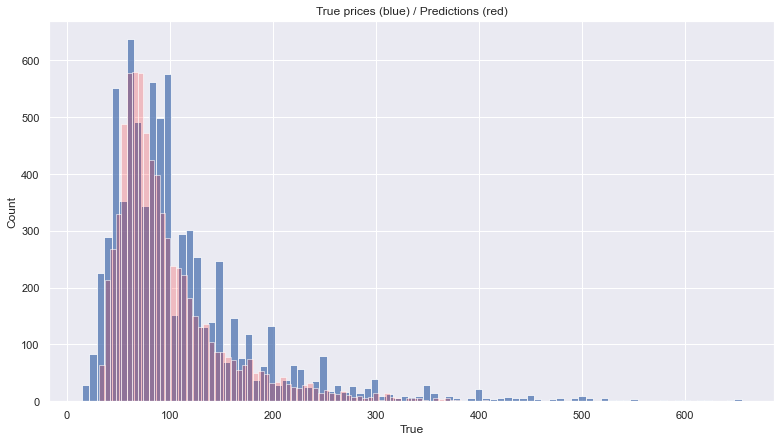

In [100]:
df_pred = pd.DataFrame(
    data = {
        'True' : y_test,
        'Pred' : y_pred })

f, ax = plt.subplots(figsize=(13, 7))
sns.histplot(data=df_pred, x="True", ax=ax)
sns.histplot(data=df_pred, x="Pred", color='red', alpha=0.2, ax=ax)
plt.title("True prices (blue) / Predictions (red)")
plt.show()

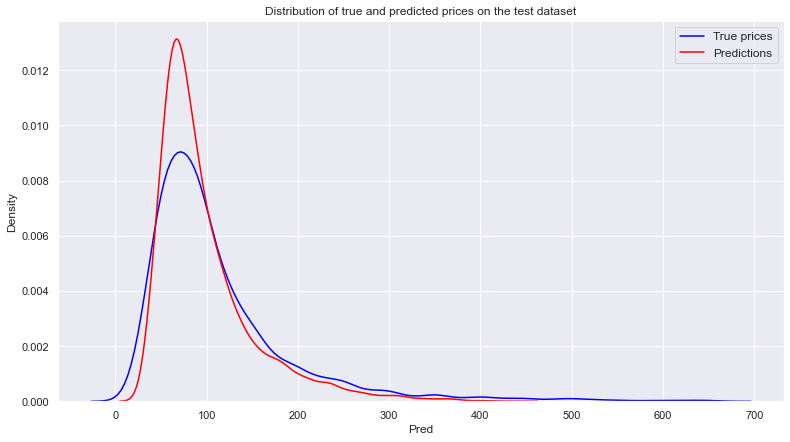

In [101]:
f, ax = plt.subplots(figsize=(13, 7))
sns.distplot(df_pred["True"], label="True prices", hist=False, color="blue", ax=ax)
sns.distplot(df_pred["Pred"], label="Predictions", hist=False, color="red", ax=ax)
ax.legend(loc='upper right', prop={'size': 12})
plt.title("Distribution of true and predicted prices on the test dataset")
plt.show()

# 10. Explainability<a class="anchor" id="Explainability"></a>

Interpretability is defined as the ability for a human to understand the reasons for a model’s decision. This criterion has become preponderant for many reasons:

- **Scientific**: It is about understanding, having confidence and having proof of the consistency and consistency of the model.


- **Ethic**: It is unacceptable to entrust the fate of people or the economy to algorithms without being able to justify the decision-making process taken by these algorithms.


- **Legislative**: [Article 22](https://www.cnil.fr/fr/profilage-et-decision-entierement-automatisee) of the RGPD (General Data Protection Regulation) provides that a person must not be the subject of a decision based exclusively on automated processing and emanating solely from the decision of a machine .

## Importance of variables extracted directly from the Model

In [102]:
result = permutation_importance(The_final_model,
                                X_train_small,
                                y_train,
                                n_repeats=10,
                                random_state=42)
importance_variables_Train = pd.DataFrame(result.importances_mean).set_index(X_train_small.columns)
importance_variables_Train.sort_values(by=0, ascending=True, inplace=True)

result = permutation_importance(The_final_model,
                                X_test_small,
                                y_test,
                                n_repeats=10,
                                random_state=42)
importance_variables_Test = pd.DataFrame(result.importances_mean).set_index(X_test_small.columns)
importance_variables_Test.sort_values(by=0, ascending=True, inplace=True)

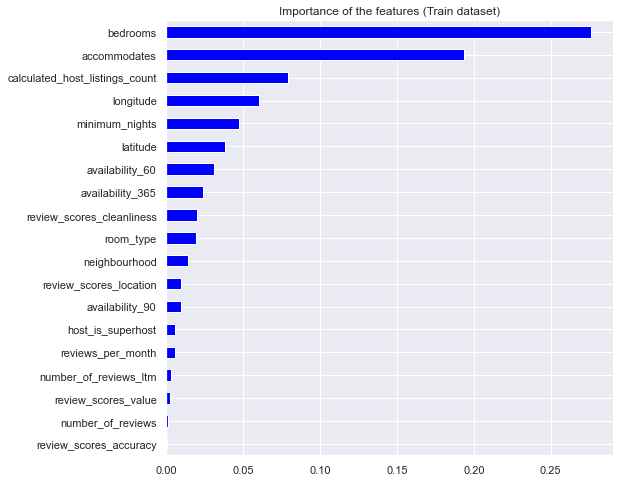

In [103]:
ax = importance_variables_Train.plot.barh(color="blue",
                                          figsize=(8,8),
                                          title="Importance of the features (Train dataset)",
                                          legend=None)

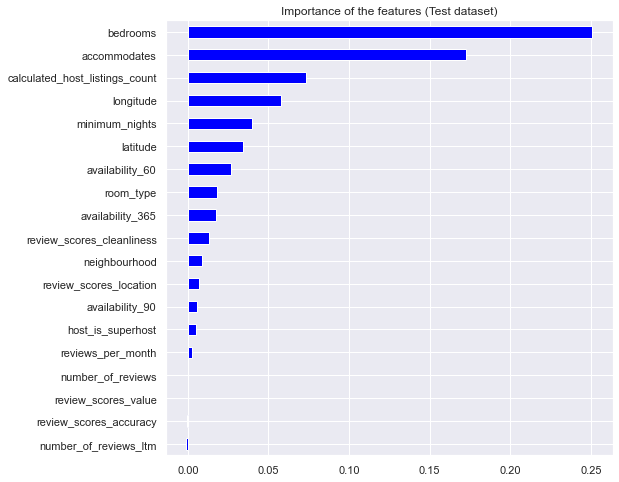

In [104]:
ax = importance_variables_Test.plot.barh(color="blue",
                                        figsize=(8,8),
                                        title="Importance of the features (Test dataset)",
                                        legend=None)

## Explanation of each rental price prediction with SHAP values

The goal of <b>SHAP</b> (<b>SH</b>apley <b>A</b>dditive ex<b>P</b>lanations) is to explain the prediction of a data instance x by computing the contribution of each feature to that prediction.

The SHAP explanation method computes Shapley values from game theory. The feature values of a data instance act as players in a coalition. The Shapley values tell us how to fairly distribute the "payoff" (= prediction) among the features. A player can be an individual feature or a set of features.

__Warning:__ SHAP consumes a lot of CPU time. It should therefore be used on a reduced data set. We will analyze an example of the rental price of an apartment of each type predicted on the test data set.

In [105]:
shap.initjs()

explainer = shap.TreeExplainer(The_final_model)

In [106]:
def ABS_SHAP(X_test):    
    """
    Plot a histogram of feature importance from SHAP values
    """
    
    shap_val = explainer.shap_values(X_test, 
                                    approximate=False, 
                                    check_additivity=False)
    
    shap_v = pd.DataFrame(shap_val)
    feature_list = X_test.columns
    shap_v.columns = feature_list
    df_v = X_test.copy().reset_index().drop('index',axis=1)
    
    # Compute the correlation for plotting with different colors 
    corr_list = list()
    for i in feature_list:
        b = np.corrcoef(shap_v[i], df_v[i])[1][0]
        corr_list.append(b)
    corr_df = pd.concat([pd.Series(feature_list),
                         pd.Series(corr_list)],axis=1).fillna(0)
    
    # Creating a Dataframe
    # Column 1 is the variable
    # Column 2 is the correlation coefficient
    corr_df.columns  = ["Variable", "Corr"]
    corr_df["Sign"] = np.where(corr_df["Corr"] > 0, "red", "blue")
    
    # Plot the graph
    shap_abs = np.abs(shap_v)
    k = pd.DataFrame(shap_abs.mean()).reset_index()
    k.columns = ["Variable", "SHAP_abs"]
    k2 = k.merge(corr_df,
                 left_on = "Variable",
                 right_on = "Variable",
                 how = "inner")
    k2 = k2.sort_values(by = "SHAP_abs", ascending = True)
    colorlist = k2["Sign"]
   
    ax = k2.plot.barh(x = "Variable",
                      y = "SHAP_abs",
                      color = colorlist, 
                      figsize=(15,8),
                      legend=False)
    
    ax.set_xlabel("SHAP values (SHapley Additive exPlanations)")
    ax.set_title("Importance of features in rental price prediction (Red = positive impact and Blue = negative impact)",
                 fontsize=14)
    
    plt.show()

### Selection of rooms with a median price by type

In [107]:
sample_room_by_type = {}
sample_price = {}
for room_type in X_test_small['room_type'].unique():
    room_type_id = Label_room_type[room_type]
    condition_1 = X_test_small['room_type'] == room_type
    X_test_filtered = X_test_small[condition_1]
    y_test_filtered = y_test[condition_1]
    sample_price[room_type_id] = y_test_filtered.median()
    condition_2 = y_test_filtered == sample_price[room_type_id]
    indice = y_test_filtered[condition_2].index.tolist()[0]
    sample_room_by_type[room_type_id] = X_test_small.loc[indice]

print("median prices (in €uros): {}".format(sample_price))
print("\nFeature values")
df_sample_room = pd.DataFrame(sample_room_by_type).T
df_sample_room

median prices (in €uros): {'Privateroom': 55.0, 'Entirehome/apt': 93.0, 'Hotelroom': 160.0, 'Sharedroom': 35.0}

Feature values


,bedrooms,accommodates,calculated_host_listings_count,longitude,minimum_nights,latitude,availability_60,room_type,availability_365,review_scores_cleanliness,availability_90,neighbourhood,reviews_per_month,number_of_reviews_ltm,host_is_superhost,review_scores_accuracy,review_scores_location,review_scores_value,number_of_reviews
Privateroom,0.02,0.1250,0.003968,0.966246,0.0001,0.999175,0.000000,0.666667,0.000000,0.984,0.000000,0.473684,0.020448,0.000000,1.0,0.992,0.972,0.988,0.029298
Entirehome/apt,0.02,0.2500,0.003968,0.971546,0.0001,0.998598,0.000000,0.000000,0.000000,0.934,0.000000,0.842105,0.003736,0.001173,0.0,0.934,0.866,0.866,0.001658
Hotelroom,0.02,0.1250,0.011905,0.963556,0.0001,0.998983,0.966667,0.333333,0.994521,1.000,0.977778,0.789474,0.003736,0.001173,1.0,0.800,0.920,0.800,0.002764
Sharedroom,0.02,0.0625,0.003968,0.931376,0.0001,0.999036,0.000000,1.000000,0.000000,0.986,0.000000,0.631579,0.027527,0.000000,0.0,0.976,0.992,0.960,0.057490


### Plot the SHAP values for the selected rooms

<span style='color:blue'>Feature importance for a room of type Privateroom (rental price = 55.0 €)</span>

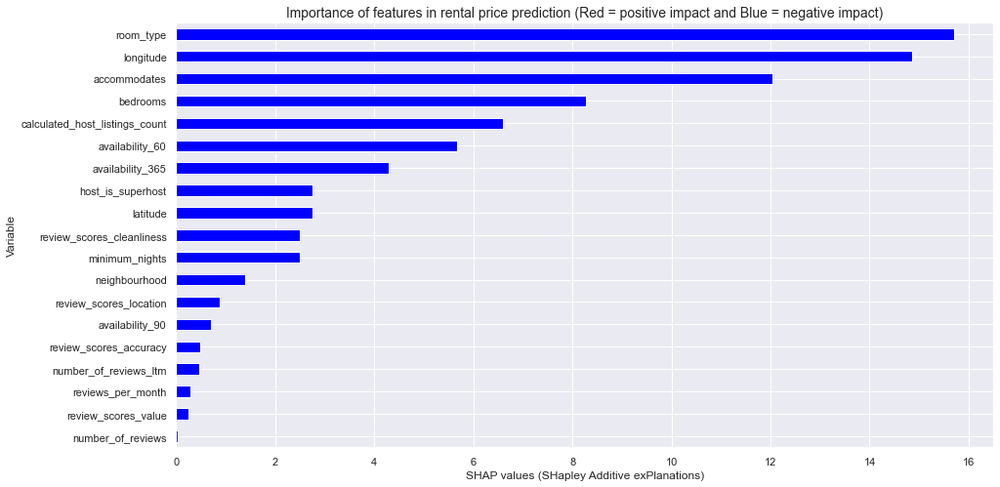


--------------------



<span style='color:blue'>Feature importance for a room of type Entirehome/apt (rental price = 93.0 €)</span>

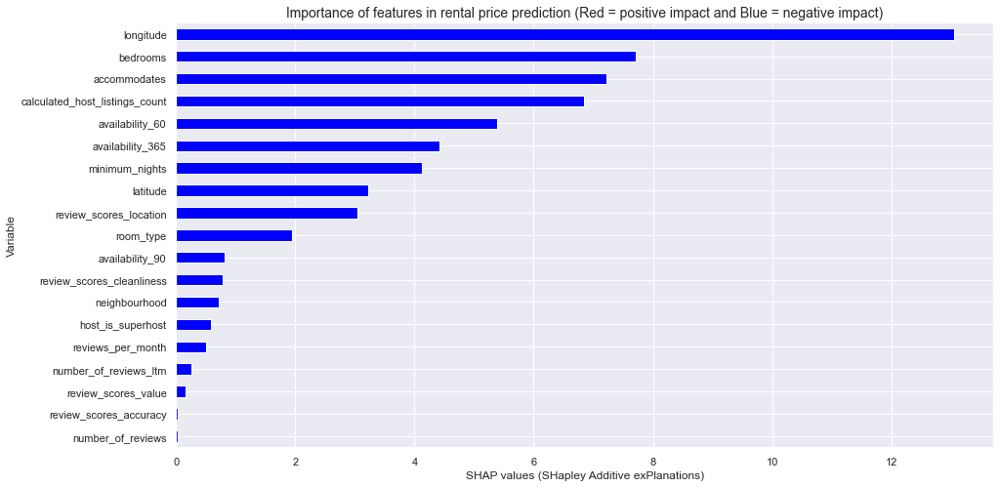


--------------------



<span style='color:blue'>Feature importance for a room of type Hotelroom (rental price = 160.0 €)</span>

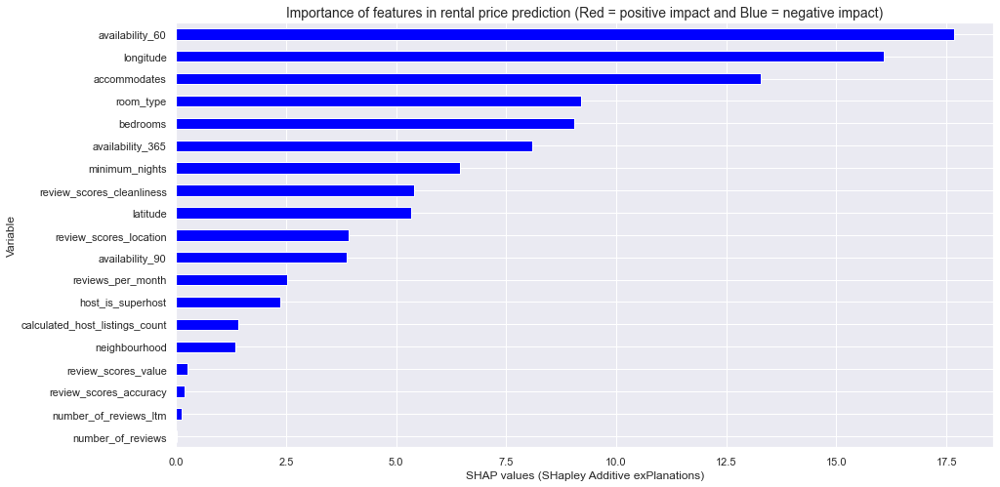


--------------------



<span style='color:blue'>Feature importance for a room of type Sharedroom (rental price = 35.0 €)</span>

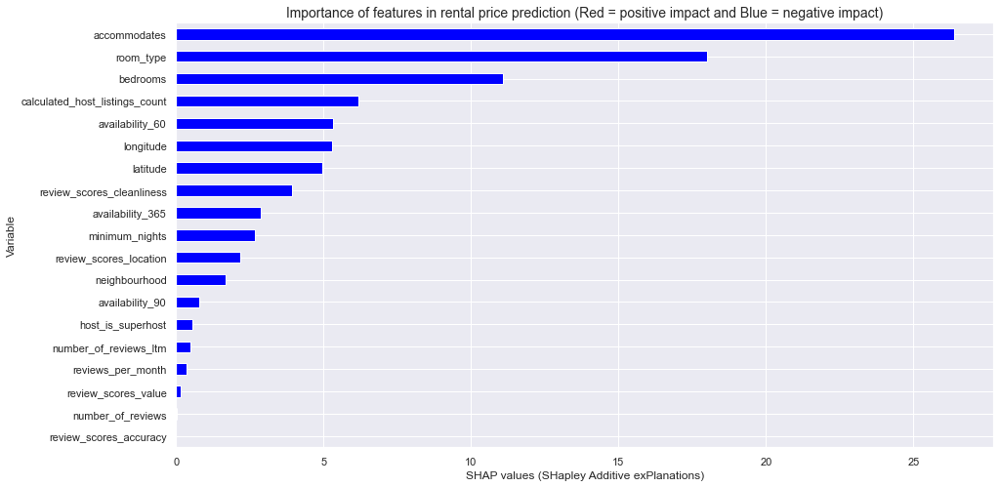


--------------------



In [108]:
for room_type in X_test_small['room_type'].unique():
    label = Label_room_type[room_type]
    printmd("Feature importance for a room of type {} (rental price = {} €)" \
            .format(label, sample_price[label]), couleur="blue")
    sample_X_test = pd.DataFrame(df_sample_room.loc[label]).T
    ABS_SHAP(sample_X_test)
    print("\n--------------------\n")

# 11. Conclusion<a class="anchor" id="Conclusion"></a>

<div class="alert alert-block alert-success">  
<p><b>We built a Machine Learning model to predict the price of an Airbnb rental in Paris.</b></p>
<p><b>After cleaning the data and analyzing the different features, we evaluated different regression models on these data.</b></p>
<p><b>We selected the features that have the most influence on the result of the regression models and optimized the hyper-parameters to obtain the best model with the MAPE metric. We chose the Mean Absolute Pourcentage Error (MAPE) because a given price gap in euros does not have the same impact for the renter of an apartment, depending on whether the price is low or high.</b></p>
<p><b>The final model with the smallest MAPE value (0.257) is: LGBMRegressor(boosting_type='dart', max_depth=6, random_state=0). The results obtained have a moderate accuracy but we could not obtain better results on the available data despite all our modeling efforts.</b></p>
<p><b>We ended our work by explaining a rental price prediction, based on the values of the different features. This explanation is important in our use cases because it indicates to the person who seeks to rent an apartment, the parameters on which he can play to optimize the price to pay.</b></p>
</div>

# Convert notebook to HTML

In [109]:
# Save the notebook before exporting it to HTML format
from ipylab import JupyterFrontEnd

app = JupyterFrontEnd()
app.commands.execute('docmanager:save')

In [110]:
!jupyter nbconvert --to HTML airbnb-starting-kit.ipynb

[NbConvertApp] Converting notebook airbnb-starting-kit.ipynb to HTML
[NbConvertApp] Writing 37115705 bytes to airbnb-starting-kit.html
